# Setting Source Folder

In [1]:
import os, sys

filedir = os.path.abspath(".")

currentdir = os.path.dirname(os.path.abspath(".")) # workaround to adding local modules

parentdir = os.path.dirname(os.path.abspath(""+currentdir))
print(f'CurrentDir: {currentdir}')
print(f'ParentDir: {parentdir}')

sys.path.insert(0, currentdir)

CurrentDir: /Users/renan.cristofalo/Documents/git/multimorbity_use
ParentDir: /Users/renan.cristofalo/Documents/git


# IMPORTAÇÃO DAS BIBLIOTECAS

In [2]:
# pip install tensorflow-metal==0.5.0 tensorflow-macos==2.9

In [3]:
# What version of Python do you have?
import sys

import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf
import platform

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

# For M1 computers = https://www.youtube.com/watch?v=5DgWvU0p2bk&ab_channel=JeffHeaton

Python Platform: macOS-13.5.2-arm64-arm-64bit
Tensor Flow Version: 2.9.0
Keras Version: 2.9.0

Python 3.9.15 | packaged by conda-forge | (main, Nov 22 2022, 08:48:25) 
[Clang 14.0.6 ]
Pandas 1.3.0
Scikit-Learn 1.1.2
GPU is available


In [4]:
import pandas as pd
import numpy as np
import joblib
import os.path as osp
import logging

from src.visualization.data_visualization import *
from src.ml.model_selection import cross_validate_models, _create_metric_msg, create_df_results, RandomizedSearch, make_dnn_model
from src.ml.utils.preprocessors import select_preprocessor
from src.ml.utils.utils import write_joblib, read_joblib
from src.utils.utils import now_str
from src.ml.evaluation.evaluate import get_metric_result
from src.config import *

from sklearn.preprocessing import MinMaxScaler,StandardScaler, FunctionTransformer, PowerTransformer

from sklearn.pipeline import Pipeline
from sklearn.base import clone

from scikeras.wrappers import KerasClassifier

#Models
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import RidgeClassifier, LogisticRegression
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier, LGBMRegressor #conda install lightgbm==3.3.2
from catboost import CatBoostClassifier
# from ngboost import NGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier, StackingClassifier
from sklearn.tree import DecisionTreeClassifier


from tensorflow.python.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# explicitly require this experimental feature
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer

# import packages for imbalanced learn
from imblearn.combine import SMOTEENN
from imblearn.pipeline import Pipeline as Imb_Pipeline
from imblearn.ensemble import RUSBoostClassifier, BalancedRandomForestClassifier

import warnings
warnings.filterwarnings("ignore")

pd.options.display.float_format = '{:,.2f}'.format
%matplotlib inline

In [5]:
N_FOLDS = 10
SEED=123
MODELS_DIR = osp.join('models','v2')


# Definining Logs

In [6]:
def define_logs(logs_path):
    """ Define the logs for the model selector

    Args:
        logs_path (str): Path to the log file
    """
    folder_path = osp.dirname(osp.abspath(logs_path))
    if not osp.exists(folder_path):
        os.makedirs(folder_path)

    log = logging.getLogger()
    log.setLevel(logging.INFO)
    fh = logging.FileHandler(filename=logs_path)
    fh.setLevel(logging.INFO)
    formatter = logging.Formatter(
                    fmt='%(asctime)s %(levelname)s: %(message)s',
                    datefmt='%Y-%m-%d %H:%M:%S'
                    )
    fh.setFormatter(formatter)
    log.addHandler(fh)
    
    return log

In [7]:
logger = define_logs(osp.join(MODELS_DIR,'logs',f'{now_str()}-model_selection.logs'))

In [8]:
import json
def is_jsonable(x):
    try:
        json.dumps(x)
        return True
    except (TypeError, OverflowError):
        return False

# Model Training

## Defining Strategies

In [9]:
ALL_PATH = osp.join ('..','data','feature_selection', 'raw')
BORUTA_PATH = osp.join ('..','data','feature_selection', 'boruta')
FS_PATH = osp.join ('..','data','feature_selection', 'fs')
FM_PATH = osp.join ('..','data','feature_selection', 'FM')
FM_MUST_PATH = osp.join ('..','data','feature_selection', 'FM_MUST')
FS_MUST_PATH = osp.join ('..','data','feature_selection', 'fs_must')

STRATEGIES = {

    'ALL_FEATURES':{ 
        'description': "Training with all available features",
        'df_train' : osp.join(ALL_PATH, 'df_train.parquet'),
        'df_test' : osp.join(ALL_PATH, 'df_test.parquet'),
    },
    
    'BORUTA':{ 
        'description': "Training with features selected by the Boruta Feature Selection",
        'df_train' : osp.join(BORUTA_PATH, 'df_train.parquet'),
        'df_test' : osp.join(BORUTA_PATH, 'df_test.parquet'),
    },
    
    'FS':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FS_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_PATH, 'df_test.parquet'),
    },
       
    'FM':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FM_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FM_PATH, 'df_test.parquet'),
    },
       
    'FM_MUST':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FM_MUST_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FM_MUST_PATH, 'df_test.parquet'),
    },
       
    'FS_MUST':{ 
        'description': "Training with filtered features selected by the Feature Selector combined with sampler SMOTEENN",
        'df_train' : osp.join(FS_MUST_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_MUST_PATH, 'df_test.parquet'),
    }
}
for strategy, dict_strategy in STRATEGIES.items():
    logger.info(f'\n*************** {strategy} ***************\n')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v) for k,v in dict_strategy.items()} , sort_keys = False, indent = 3, skipkeys=True))
    
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'\ndf_train shape: {df_train.shape} \n df_test shape: {df_test.shape}\n')

## Defining Metrics

In [10]:
metrics={
        'accuracy'      :   'accuracy',
        'balanced_acc'  :   'balanced_accuracy',
        'F1'            :   'f1',
        'Precision'     :   'precision',
        'recall'        :   'recall',
        'roc_auc'       :   'roc_auc',
        } 

## Defining Sklearn Models

In [11]:
models = []

# Make a pipeline for the model, scaling and making a cross validation for each of them
models.append({'name':"Dummy"
             , 'model': DummyClassifier()
             })

models.append({'name':"LogisticRegression"
             , 'model': LogisticRegression()
             })

models.append({'name':"DecisionTreeClassifier"
             , 'model': DecisionTreeClassifier(min_samples_split=0.005, min_samples_leaf=0.001,random_state=SEED)
             })

models.append({'name':"RandomForestClassifier"
             , 'model': RandomForestClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"ExtraTreesClassifier"
             , 'model': ExtraTreesClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"GradientBoostingClassifier"
             , 'model': GradientBoostingClassifier(max_depth = 7, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             }) 

models.append({'name':"XGBoostClassifier"
             , 'model': XGBClassifier(max_depth = 7, random_state = SEED)
             }) 

models.append({'name':"XGBoostClassifier_Default"
             , 'model': XGBClassifier(random_state = SEED)
             }) 

models.append({'name':"LGBMClassifier"
             , 'model': LGBMClassifier(max_depth = 7, verbose=0, random_state = SEED)
             }) 

models.append({'name':"LGBMClassifier_Default"
             , 'model': LGBMClassifier(random_state = SEED)
             }) 

models.append({'name':"CatBoostClassifier"
             , 'model': CatBoostClassifier(max_depth = 7, verbose=0, random_state = SEED)
             }) 

models.append({'name':"CatBoostClassifier_Default"
             , 'model': CatBoostClassifier(random_state = SEED)
             }) 

models.append({'name':"BalancedRandomForestClassifier"
             , 'model': BalancedRandomForestClassifier(random_state = SEED)
             }) 

models.append({'name':"RUSBoostClassifier"
             , 'model': RUSBoostClassifier(random_state = SEED)
             }) 

models.append({'name':"VotingClassifier"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('catboost',CatBoostClassifier(max_depth=10, verbose=False)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
            ], voting = 'soft')
            }) 

models.append({'name':"StackingClassifier"
             , 'model': StackingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
                ('lgbm', LGBMClassifier(max_depth=10)),
            ])
            }) 


## Defining Tensorflow Models

In [12]:
# models = []

PATIENCE=5
NUM_EPOCHS = 30

BATCH_SIZE=1024
seed = 42
verbose=0


callbacks ={
'EarlyStopping': tf.keras.callbacks.EarlyStopping,
}
tf_metrics = ['accuracy'] #https://www.tensorflow.org/api_docs/python/tf/keras/metrics

models.append({'name':"DNN_01"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_02"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 512, 256, 128, 64, 32),
               dropout_rate = 1/N_FOLDS,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_03"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (128, 64, 32),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 

models.append({'name':"DNN_04"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (32, 16, 8),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )
             }) 


models.append({'name':"VotingClassifierDNN_01"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('DNN_01',KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=1/N_FOLDS,
               verbose=0
               )),
            ], voting = 'soft')
            }) 



## Running Models' Training

In [13]:
for strategy, dict_strategy in STRATEGIES.items():
    
    # logging strategy
    logger.info(f'*************** {strategy} ***************')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v)for k,v in dict_strategy.items() } , sort_keys = False, indent = 4, skipkeys=True))
      
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    imbalanced_sampler = dict_strategy.get('imbalanced_sampler', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'df_train shape: {df_train.shape}')
    logger.info(f'df_test shape: {df_test.shape}')   
    
    X_train_= df_train.drop([TARGET], axis=1)
    y_train_ = df_train[TARGET]
    X_test_ = df_test.drop([TARGET], axis=1)
    y_test_ = df_test[TARGET]

    # Adding preprocessor
    preprocessor = None
    preprocessor = select_preprocessor('TargetEncoding', X = X_train_)
    
    strategy_models = []
    if imbalanced_sampler:
        df_train=pd.read_parquet(df_train_path).sample(10000)
        X_train_= df_train.drop([TARGET], axis=1)
        y_train_ = df_train[TARGET]
        
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Imb_Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('sampling', imbalanced_sampler),
                    ('model', model['model'])
                ])
            })
    else:
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('model', model['model'])
                ])
            })
    
    names, results, df_results = cross_validate_models(
        models = strategy_models
        , X_train = X_train_
        , y_train = y_train_
        , X_test = X_test_
        , y_test = y_test_
        , metrics = metrics
        , n_folds = N_FOLDS
        , models_dir = MODELS_DIR
        )

  0%|          | 0/21 [00:00<?, ?it/s]


AVERAGES - ALL_FEATURES_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.23s (+/- 0.03s)



  5%|▍         | 1/21 [00:10<03:25, 10.29s/it]


AVERAGES - ALL_FEATURES_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.82 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.81 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.06) | TEST: 0.57 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.91 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.37s (+/- 0.05s)



 10%|▉         | 2/21 [00:22<03:35, 11.35s/it]


AVERAGES - ALL_FEATURES_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.91 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.91 (+/- 0.00) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.56 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.50 (+/- 0.03) | TEST: 0.53 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.35s (+/- 0.01s)



 14%|█▍        | 3/21 [00:34<03:28, 11.57s/it]


AVERAGES - ALL_FEATURES_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.02) | TEST: 0.61 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.02) | TEST: 0.62 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.73 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.80 (+/- 0.01) | VALIDATION: 0.65 (+/- 0.03) | TEST: 0.68 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.66 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.51 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.85 (+/- 0.00) | VALIDATION: 0.68 (+/- 0.04) | TEST: 0.67 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.44s (+/- 0.03s)



 19%|█▉        | 4/21 [00:48<03:32, 12.50s/it]


AVERAGES - ALL_FEATURES_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.72 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.82 (+/- 0.01) | VALIDATION: 0.65 (+/- 0.04) | TEST: 0.69 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.64 (+/- 0.01) | VALIDATION: 0.51 (+/- 0.05) | TEST: 0.51 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.84 (+/- 0.00) | VALIDATION: 0.68 (+/- 0.04) | TEST: 0.67 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.46s (+/- 0.02s)



 24%|██▍       | 5/21 [01:02<03:29, 13.08s/it]


AVERAGES - ALL_FEATURES_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 7.81s (+/- 0.12s)



 29%|██▊       | 6/21 [02:37<10:14, 40.98s/it]


AVERAGES - ALL_FEATURES_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.05s (+/- 0.08s)



 33%|███▎      | 7/21 [03:08<08:48, 37.77s/it]


AVERAGES - ALL_FEATURES_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.57 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.78s (+/- 0.05s)



 38%|███▊      | 8/21 [03:36<07:31, 34.73s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015996 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

 43%|████▎     | 9/21 [03:51<05:41, 28.43s/it]


AVERAGES - ALL_FEATURES_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.63 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.79s (+/- 0.11s)



 48%|████▊     | 10/21 [04:08<04:36, 25.09s/it]


AVERAGES - ALL_FEATURES_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.61 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.64 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.66 (+/- 0.03) | TEST: 0.64 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 11.17s (+/- 0.41s)



 52%|█████▏    | 11/21 [06:37<10:27, 62.79s/it]

Learning rate set to 0.014423
0:	learn: 0.6909577	total: 6.38ms	remaining: 6.37s
1:	learn: 0.6889578	total: 12.6ms	remaining: 6.3s
2:	learn: 0.6864730	total: 18.8ms	remaining: 6.24s
3:	learn: 0.6846564	total: 25.3ms	remaining: 6.31s
4:	learn: 0.6822955	total: 31.2ms	remaining: 6.2s
5:	learn: 0.6797699	total: 37.1ms	remaining: 6.14s
6:	learn: 0.6777693	total: 43.5ms	remaining: 6.17s
7:	learn: 0.6754348	total: 49.4ms	remaining: 6.12s
8:	learn: 0.6730680	total: 55.3ms	remaining: 6.09s
9:	learn: 0.6707190	total: 62.8ms	remaining: 6.22s
10:	learn: 0.6687506	total: 69.9ms	remaining: 6.28s
11:	learn: 0.6669819	total: 75.8ms	remaining: 6.24s
12:	learn: 0.6651204	total: 82.2ms	remaining: 6.24s
13:	learn: 0.6633379	total: 88.2ms	remaining: 6.21s
14:	learn: 0.6617506	total: 94.3ms	remaining: 6.19s
15:	learn: 0.6599242	total: 101ms	remaining: 6.22s
16:	learn: 0.6577620	total: 108ms	remaining: 6.22s
17:	learn: 0.6563373	total: 114ms	remaining: 6.22s
18:	learn: 0.6547996	total: 121ms	remaining: 6.24

 57%|█████▋    | 12/21 [08:19<11:12, 74.68s/it]


AVERAGES - ALL_FEATURES_BALANCEDRANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.65 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.68 (+/- 0.04) | TEST: 0.66 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.87s (+/- 0.03s)



 62%|██████▏   | 13/21 [08:39<07:45, 58.22s/it]


AVERAGES - ALL_FEATURES_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.74 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.74 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.73 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.73 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.58 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.28s (+/- 0.02s)



 67%|██████▋   | 14/21 [09:07<05:43, 49.09s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [20:09<23:23, 233.89s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [23:21<18:25, 221.12s/it]

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



2023-09-21 16:42:58.863481: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-09-21 16:42:58.864466: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-09-21 16:42:59.712253: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-09-21 16:42:59.981292: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:02.557697: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:03.365967: I tensorflow/core/grappler/o


AVERAGES - ALL_FEATURES_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.60 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.58 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.59 (+/- 0.02) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.59 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.51 (+/- 0.10) | VALIDATION: 0.51 (+/- 0.11) | TEST: 0.53 (+/- 0.10)
 - PRECISION              ->  - TRAIN: 0.61 (+/- 0.03) | VALIDATION: 0.59 (+/- 0.06) | TEST: 0.65 (+/- 0.03)
 - RECALL                 ->  - TRAIN: 0.47 (+/- 0.15) | VALIDATION: 0.47 (+/- 0.15) | TEST: 0.47 (+/- 0.14)
 - ROC_AUC                ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.05) | TEST: 0.63 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.36s (+/- 0.84s)



2023-09-21 16:43:36.650092: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:37.613077: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp66_0kgce/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpuv8uixyx/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3q5_qm68/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpajpbdq13/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptn4drogu/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpeckxzszn/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpskk2xtw3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpwwhf9hq8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpcutej_rv/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [24:09<11:16, 169.21s/it]2023-09-21 16:43:47.846610: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:49.706896: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:50.799635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:52.366769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:53.223869: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:54.374849: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:43:55.97


AVERAGES - ALL_FEATURES_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.59 (+/- 0.03) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.56 (+/- 0.05)
 - BALANCED_ACC           ->  - TRAIN: 0.58 (+/- 0.04) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.57 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.41 (+/- 0.20) | VALIDATION: 0.39 (+/- 0.19) | TEST: 0.41 (+/- 0.21)
 - PRECISION              ->  - TRAIN: 0.58 (+/- 0.20) | VALIDATION: 0.56 (+/- 0.20) | TEST: 0.61 (+/- 0.21)
 - RECALL                 ->  - TRAIN: 0.35 (+/- 0.21) | VALIDATION: 0.33 (+/- 0.19) | TEST: 0.35 (+/- 0.21)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.05) | TEST: 0.64 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 3.20s (+/- 0.29s)



2023-09-21 16:44:35.400848: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:36.853534: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpezknm25_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp9isvrqau/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptqzp9sia/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpyvalpvzl/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjg2a26vm/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2mxsslow/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpoeurqpvh/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpe5u58crj/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6vqckig3/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [25:09<06:49, 136.36s/it]2023-09-21 16:44:47.841426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:48.794019: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:50.301387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:51.531155: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:52.300897: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:53.266961: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:44:54.43


AVERAGES - ALL_FEATURES_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.63 (+/- 0.02) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.59 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.62 (+/- 0.02) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.54 (+/- 0.07) | VALIDATION: 0.50 (+/- 0.07) | TEST: 0.53 (+/- 0.06)
 - PRECISION              ->  - TRAIN: 0.66 (+/- 0.02) | VALIDATION: 0.61 (+/- 0.05) | TEST: 0.67 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.47 (+/- 0.10) | VALIDATION: 0.44 (+/- 0.10) | TEST: 0.45 (+/- 0.09)
 - ROC_AUC                ->  - TRAIN: 0.69 (+/- 0.02) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.65 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.80s (+/- 0.30s)



2023-09-21 16:45:29.660839: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:30.628266: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpthyvb80w/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpuks47i8v/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpehyjl6vy/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprl5hpuy_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmkqvjxdw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnkrqvykc/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2sq03_75/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpayub4x49/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpokkvbbq6/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [25:58<03:40, 110.19s/it]2023-09-21 16:45:36.846478: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:38.149007: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:39.821080: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:41.259271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:42.412113: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:43.562572: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:45:45.03


AVERAGES - ALL_FEATURES_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.61 (+/- 0.05) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.58 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.61 (+/- 0.04) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.58 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.55 (+/- 0.06) | VALIDATION: 0.52 (+/- 0.07) | TEST: 0.53 (+/- 0.08)
 - PRECISION              ->  - TRAIN: 0.65 (+/- 0.07) | VALIDATION: 0.61 (+/- 0.06) | TEST: 0.66 (+/- 0.05)
 - RECALL                 ->  - TRAIN: 0.51 (+/- 0.18) | VALIDATION: 0.49 (+/- 0.19) | TEST: 0.49 (+/- 0.19)
 - ROC_AUC                ->  - TRAIN: 0.67 (+/- 0.05) | VALIDATION: 0.61 (+/- 0.07) | TEST: 0.62 (+/- 0.05)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 3.88s (+/- 0.59s)



2023-09-21 16:46:30.048911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:30.896439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3tlzuyi7/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpsn0vpklx/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjjnnhlyo/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp84gv716i/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpf0z2dneu/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3xti4nbm/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp86wtnq5b/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpn7yso9sr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2ugyeuc9/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [27:00<01:35, 95.67s/it] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:46:39.234138: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:40.434525: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:42.021714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:46:43.830569: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:45.153455: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:46.366328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:46:48.219252: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:49.397988: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:51.180065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:46:53.165939: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:54.508642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:55.674155: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:46:57.492333: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:46:58.808422: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:00.449544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:02.262621: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:03.562566: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:05.123411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:07.224687: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:08.695352: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:10.249548: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:12.386493: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:14.027189: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:15.540953: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:17.495966: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:18.959205: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:20.278807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:22.139009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:23.565825: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:24.914789: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:25.682145: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:25.931948: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:26.176147: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:26.408032: I tensorflow/core/grappler/optimizers/cust


AVERAGES - ALL_FEATURES_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.61 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.64 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.58 (+/- 0.03)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.66 (+/- 0.04) | TEST: 0.64 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 4.04s (+/- 0.23s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:47:35.612727: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:47:37.384253: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1hpppky0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzgqozi4y/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgy7wsqw5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpoachw0fp/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpyncf6dex/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4_ppxp95/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpk5znxh9h/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpn3bo3o5o/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpr27zvq0t/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:00<00:15,  1.33it/s]


AVERAGES - BORUTA_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.02s (+/- 0.00s)



 10%|▉         | 2/21 [00:01<00:17,  1.08it/s]


AVERAGES - BORUTA_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.57 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.57 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.67 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.64 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.04s)



 14%|█▍        | 3/21 [00:02<00:15,  1.15it/s]


AVERAGES - BORUTA_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.84 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.84 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.85 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.57 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.81 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.50 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.02s (+/- 0.00s)


AVERAGES - BORUTA_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.02) | TEST: 

 19%|█▉        | 4/21 [00:05<00:29,  1.71s/it]


AVERAGES - BORUTA_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.64 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.64 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.58 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.49 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.66 (+/- 0.03) | TEST: 0.61 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.07s (+/- 0.00s)



 24%|██▍       | 5/21 [00:07<00:30,  1.88s/it]


AVERAGES - BORUTA_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.85 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.85 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.80 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.50 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.94 (+/- 0.01) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.29s (+/- 0.00s)



 29%|██▊       | 6/21 [00:11<00:39,  2.63s/it]


AVERAGES - BORUTA_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.97 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.52 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.16s (+/- 0.03s)



 33%|███▎      | 7/21 [00:14<00:36,  2.60s/it]


AVERAGES - BORUTA_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.52 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.15s (+/- 0.06s)



 38%|███▊      | 8/21 [00:16<00:33,  2.56s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000696 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:20<00:33,  2.82s/it]


AVERAGES - BORUTA_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.85 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.81 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.51 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.94 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.30s (+/- 0.02s)



 48%|████▊     | 10/21 [00:24<00:35,  3.23s/it]


AVERAGES - BORUTA_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.81 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.81 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.79 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.76 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.51 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.90 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.03s (+/- 0.05s)



 52%|█████▏    | 11/21 [00:36<00:59,  5.93s/it]

Learning rate set to 0.014423
0:	learn: 0.6914340	total: 553us	remaining: 553ms
1:	learn: 0.6889406	total: 1.38ms	remaining: 689ms
2:	learn: 0.6862537	total: 2.21ms	remaining: 735ms
3:	learn: 0.6836027	total: 2.99ms	remaining: 745ms
4:	learn: 0.6813071	total: 3.78ms	remaining: 753ms
5:	learn: 0.6788573	total: 4.64ms	remaining: 768ms
6:	learn: 0.6764414	total: 5.39ms	remaining: 765ms
7:	learn: 0.6741545	total: 6.15ms	remaining: 763ms
8:	learn: 0.6717865	total: 6.88ms	remaining: 758ms
9:	learn: 0.6694779	total: 7.63ms	remaining: 755ms
10:	learn: 0.6675028	total: 8.41ms	remaining: 757ms
11:	learn: 0.6653076	total: 9.19ms	remaining: 757ms
12:	learn: 0.6630161	total: 9.97ms	remaining: 757ms
13:	learn: 0.6612329	total: 10.7ms	remaining: 753ms
14:	learn: 0.6593357	total: 11.4ms	remaining: 751ms
15:	learn: 0.6576793	total: 12.2ms	remaining: 752ms
16:	learn: 0.6556180	total: 13ms	remaining: 752ms
17:	learn: 0.6535136	total: 13.7ms	remaining: 747ms
18:	learn: 0.6520912	total: 14.3ms	remaining: 7

 57%|█████▋    | 12/21 [00:46<01:04,  7.19s/it]

933:	learn: 0.4697650	total: 754ms	remaining: 53.3ms
934:	learn: 0.4695893	total: 755ms	remaining: 52.5ms
935:	learn: 0.4694778	total: 756ms	remaining: 51.7ms
936:	learn: 0.4693320	total: 757ms	remaining: 50.9ms
937:	learn: 0.4692117	total: 757ms	remaining: 50.1ms
938:	learn: 0.4691395	total: 759ms	remaining: 49.3ms
939:	learn: 0.4690507	total: 760ms	remaining: 48.5ms
940:	learn: 0.4689919	total: 760ms	remaining: 47.7ms
941:	learn: 0.4689862	total: 761ms	remaining: 46.9ms
942:	learn: 0.4688959	total: 762ms	remaining: 46.1ms
943:	learn: 0.4688678	total: 763ms	remaining: 45.3ms
944:	learn: 0.4687630	total: 764ms	remaining: 44.5ms
945:	learn: 0.4686443	total: 765ms	remaining: 43.6ms
946:	learn: 0.4685208	total: 765ms	remaining: 42.8ms
947:	learn: 0.4684508	total: 766ms	remaining: 42ms
948:	learn: 0.4683180	total: 767ms	remaining: 41.2ms
949:	learn: 0.4681793	total: 768ms	remaining: 40.4ms
950:	learn: 0.4681407	total: 768ms	remaining: 39.6ms
951:	learn: 0.4680385	total: 769ms	remaining: 38

 62%|██████▏   | 13/21 [00:52<00:53,  6.74s/it]


AVERAGES - BORUTA_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.01) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.01) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.68 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.01) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.69 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.67 (+/- 0.02) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.55 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.77 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.09s (+/- 0.01s)



 67%|██████▋   | 14/21 [00:54<00:37,  5.39s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [01:33<01:32, 15.39s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [02:04<01:41, 20.34s/it]2023-09-21 16:49:53.625205: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:49:55.696576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:49:57.849413: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:49:58.953755: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:50:00.725388: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:50:02.853925: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:50:03.915


AVERAGES - BORUTA_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.61 (+/- 0.04) | VALIDATION: 0.60 (+/- 0.05) | TEST: 0.58 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.60 (+/- 0.03) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.58 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.56 (+/- 0.05) | VALIDATION: 0.56 (+/- 0.06) | TEST: 0.55 (+/- 0.06)
 - PRECISION              ->  - TRAIN: 0.62 (+/- 0.05) | VALIDATION: 0.62 (+/- 0.07) | TEST: 0.65 (+/- 0.05)
 - RECALL                 ->  - TRAIN: 0.55 (+/- 0.18) | VALIDATION: 0.55 (+/- 0.18) | TEST: 0.52 (+/- 0.18)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.02) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 4.61s (+/- 0.57s)



2023-09-21 16:50:48.152555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:50:49.986984: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpy1po6cez/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxjdlpw4i/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4dmehd7p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpffau9xwt/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbpkqtbbh/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpb3ko1ah8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7_sxrtur/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmppjqdjdw6/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo48xrodc/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [03:11<02:16, 34.14s/it]2023-09-21 16:50:59.811751: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:02.072537: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:05.248990: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:06.550575: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:08.559033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:11.876589: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:51:13.042


AVERAGES - BORUTA_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.58 (+/- 0.06) | VALIDATION: 0.56 (+/- 0.06) | TEST: 0.56 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.58 (+/- 0.05) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.55 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.56 (+/- 0.17) | VALIDATION: 0.54 (+/- 0.18) | TEST: 0.55 (+/- 0.18)
 - PRECISION              ->  - TRAIN: 0.59 (+/- 0.07) | VALIDATION: 0.56 (+/- 0.06) | TEST: 0.60 (+/- 0.05)
 - RECALL                 ->  - TRAIN: 0.64 (+/- 0.28) | VALIDATION: 0.62 (+/- 0.29) | TEST: 0.61 (+/- 0.28)
 - ROC_AUC                ->  - TRAIN: 0.65 (+/- 0.03) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.61 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 5.84s (+/- 1.20s)



2023-09-21 16:52:10.181725: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:12.931115: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpv1yiut8h/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpg3ku_avs/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp0qjcq3sd/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjj9cm2js/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpj8cum0k_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpx4ty9ny_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpc2arhdo7/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzxdg5_nl/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7qqhk6db/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [04:36<02:28, 49.40s/it]2023-09-21 16:52:24.976995: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:26.223688: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:28.982511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:29.947133: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:31.175936: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:33.376799: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:52:34.103


AVERAGES - BORUTA_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.61 (+/- 0.04) | VALIDATION: 0.60 (+/- 0.06) | TEST: 0.58 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.61 (+/- 0.04) | VALIDATION: 0.60 (+/- 0.05) | TEST: 0.58 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.58 (+/- 0.05) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.57 (+/- 0.06)
 - PRECISION              ->  - TRAIN: 0.62 (+/- 0.05) | VALIDATION: 0.61 (+/- 0.07) | TEST: 0.64 (+/- 0.05)
 - RECALL                 ->  - TRAIN: 0.58 (+/- 0.18) | VALIDATION: 0.57 (+/- 0.17) | TEST: 0.55 (+/- 0.19)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.02) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 4.75s (+/- 0.58s)



2023-09-21 16:53:19.947950: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:21.293356: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpuhmsbgae/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa0qyx0hd/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4gtsg812/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbxf3aktt/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxc9_rdaw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp874ildbk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp04tztm9_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpx57sgj9f/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmrm6ez8s/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [05:39<01:47, 53.63s/it]2023-09-21 16:53:28.201181: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:30.313672: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:32.817765: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:33.768278: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:35.174293: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:36.430111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:53:37.280


AVERAGES - BORUTA_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.54 (+/- 0.06) | VALIDATION: 0.54 (+/- 0.07) | TEST: 0.54 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.55 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.06) | TEST: 0.54 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.51 (+/- 0.19) | VALIDATION: 0.52 (+/- 0.19) | TEST: 0.52 (+/- 0.20)
 - PRECISION              ->  - TRAIN: 0.57 (+/- 0.09) | VALIDATION: 0.51 (+/- 0.20) | TEST: 0.65 (+/- 0.14)
 - RECALL                 ->  - TRAIN: 0.62 (+/- 0.34) | VALIDATION: 0.62 (+/- 0.34) | TEST: 0.60 (+/- 0.35)
 - ROC_AUC                ->  - TRAIN: 0.59 (+/- 0.06) | VALIDATION: 0.61 (+/- 0.06) | TEST: 0.58 (+/- 0.05)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 4.95s (+/- 0.88s)



2023-09-21 16:54:25.621212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:27.579016: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp0o8ws02f/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp971vzgd_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_37mgrsf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp473j40rk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpspi_8opf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_6iebxo_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpuognal8d/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpf1box4lz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmppac6zkba/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [06:46<00:57, 57.48s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:54:35.024522: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:37.179905: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:40.037441: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:54:41.408323: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:43.901507: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:46.297788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:54:47.713016: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:49.745756: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:52.476501: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:54:54.126986: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:56.346969: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:54:58.943065: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:00.408824: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:02.334747: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:04.756886: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:06.424758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:09.177829: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:12.238657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:13.858371: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:16.803276: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:19.689538: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:21.114503: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:22.990407: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:26.573224: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:28.101814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:30.386243: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:32.918787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:34.178011: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:36.365930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:39.498507: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:40.144695: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:40.441292: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:40.708973: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:40.978690: I tensorflow/core/grappler/optimizers/cust


AVERAGES - BORUTA_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.53 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 6.09s (+/- 0.49s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 16:55:46.801601: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:55:49.715405: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpeuzp17gz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8w7zyip3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprjsj81dt/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpti2r1x_l/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpyd9qh5rf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpeydxkme0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjdhp70xq/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp__9aytm8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpi0_glgpj/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:01<00:31,  1.60s/it]


AVERAGES - FS_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.08s (+/- 0.13s)



 10%|▉         | 2/21 [00:02<00:27,  1.42s/it]


AVERAGES - FS_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.69 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.63 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.66 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.79 (+/- 0.00) | VALIDATION: 0.65 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.00s)



 14%|█▍        | 3/21 [00:04<00:23,  1.32s/it]


AVERAGES - FS_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.87 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.87 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.54 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.84 (+/- 0.02) | VALIDATION: 0.52 (+/- 0.05) | TEST: 0.51 (+/- 0.03)
 - ROC_AUC                ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.00s)


AVERAGES - FS_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.75 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.59 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.59 (+/

 19%|█▉        | 4/21 [00:07<00:37,  2.22s/it]


AVERAGES - FS_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.73 (+/- 0.01) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.65 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.61 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.50 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.78 (+/- 0.00) | VALIDATION: 0.66 (+/- 0.03) | TEST: 0.63 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.09s (+/- 0.01s)



 24%|██▍       | 5/21 [00:10<00:38,  2.41s/it]


AVERAGES - FS_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.92 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.46s (+/- 0.01s)



 29%|██▊       | 6/21 [00:16<00:55,  3.68s/it]


AVERAGES - FS_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.22s (+/- 0.02s)



 33%|███▎      | 7/21 [00:19<00:50,  3.58s/it]


AVERAGES - FS_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.97 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.18s (+/- 0.02s)



 38%|███▊      | 8/21 [00:22<00:44,  3.39s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:26<00:42,  3.51s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

AVERAGES - FS_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.94 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.94 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.60 (+/- 0.01)


 48%|████▊     | 10/21 [00:31<00:42,  3.83s/it]


AVERAGES - FS_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.86 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.08s (+/- 0.02s)



 52%|█████▏    | 11/21 [00:44<01:05,  6.58s/it]

Learning rate set to 0.014423
0:	learn: 0.6907036	total: 847us	remaining: 847ms
1:	learn: 0.6884570	total: 1.56ms	remaining: 781ms
2:	learn: 0.6857382	total: 2.44ms	remaining: 810ms
3:	learn: 0.6834220	total: 3.21ms	remaining: 799ms
4:	learn: 0.6808317	total: 4.01ms	remaining: 798ms
5:	learn: 0.6783380	total: 4.8ms	remaining: 795ms
6:	learn: 0.6759777	total: 5.56ms	remaining: 789ms
7:	learn: 0.6731201	total: 6.37ms	remaining: 790ms
8:	learn: 0.6709701	total: 7.06ms	remaining: 777ms
9:	learn: 0.6682951	total: 7.71ms	remaining: 764ms
10:	learn: 0.6661839	total: 8.55ms	remaining: 769ms
11:	learn: 0.6641034	total: 9.24ms	remaining: 761ms
12:	learn: 0.6623494	total: 10.1ms	remaining: 767ms
13:	learn: 0.6601302	total: 11.4ms	remaining: 803ms
14:	learn: 0.6583497	total: 12.3ms	remaining: 808ms
15:	learn: 0.6564141	total: 13.1ms	remaining: 808ms
16:	learn: 0.6542166	total: 13.9ms	remaining: 806ms
17:	learn: 0.6522462	total: 14.8ms	remaining: 807ms
18:	learn: 0.6505185	total: 15.7ms	remaining: 

 57%|█████▋    | 12/21 [00:55<01:11,  7.96s/it]


AVERAGES - FS_BALANCEDRANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.61 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.31s (+/- 0.06s)



 62%|██████▏   | 13/21 [01:02<01:01,  7.68s/it]


AVERAGES - FS_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.72 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.72 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.58 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.80 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.12s (+/- 0.01s)



 67%|██████▋   | 14/21 [01:05<00:43,  6.24s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [01:49<01:46, 17.73s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [02:25<01:55, 23.12s/it]2023-09-21 16:58:25.791372: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:29.081159: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:31.978221: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:33.203218: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:35.419764: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:38.626658: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:58:39.995


AVERAGES - FS_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.60 (+/- 0.02) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.60 (+/- 0.02) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.58 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.58 (+/- 0.11) | VALIDATION: 0.56 (+/- 0.13) | TEST: 0.58 (+/- 0.12)
 - PRECISION              ->  - TRAIN: 0.60 (+/- 0.05) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.63 (+/- 0.04)
 - RECALL                 ->  - TRAIN: 0.62 (+/- 0.21) | VALIDATION: 0.60 (+/- 0.23) | TEST: 0.58 (+/- 0.20)
 - ROC_AUC                ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.65 (+/- 0.05) | TEST: 0.63 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 6.77s (+/- 0.60s)



2023-09-21 16:59:45.214939: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 16:59:48.382553: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmph6uewx4v/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1_we_h16/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphbd64k6q/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpppmlpybs/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphxhe8oy3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgk3bzwm8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmplh_9itnz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp59gto9zx/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjhu3t2h_/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [04:02<03:02, 45.53s/it]2023-09-21 17:00:03.077736: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:05.714985: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:11.653333: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:13.601260: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:17.088229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:22.451266: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:00:24.180


AVERAGES - FS_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.57 (+/- 0.04) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.55 (+/- 0.05)
 - BALANCED_ACC           ->  - TRAIN: 0.57 (+/- 0.05) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.55 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.48 (+/- 0.27) | VALIDATION: 0.46 (+/- 0.27) | TEST: 0.47 (+/- 0.28)
 - PRECISION              ->  - TRAIN: 0.47 (+/- 0.24) | VALIDATION: 0.43 (+/- 0.22) | TEST: 0.48 (+/- 0.24)
 - RECALL                 ->  - TRAIN: 0.57 (+/- 0.36) | VALIDATION: 0.56 (+/- 0.36) | TEST: 0.53 (+/- 0.35)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.03) | VALIDATION: 0.65 (+/- 0.04) | TEST: 0.63 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 8.56s (+/- 1.02s)



2023-09-21 17:01:43.452403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:01:47.711086: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpy31mudog/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpest01vc9/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzp3091wr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpulfi4gig/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbucodchs/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnpsixjir/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4cl74hmq/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmooufz3y/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmps7gqwjyo/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [06:00<03:21, 67.32s/it]2023-09-21 17:02:01.047489: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:03.595581: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:07.455471: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:08.650473: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:11.159962: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:14.797959: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:02:16.105


AVERAGES - FS_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.63 (+/- 0.01) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.62 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.59 (+/- 0.04) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.59 (+/- 0.04)
 - PRECISION              ->  - TRAIN: 0.62 (+/- 0.02) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.65 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.57 (+/- 0.08) | VALIDATION: 0.56 (+/- 0.07) | TEST: 0.54 (+/- 0.07)
 - ROC_AUC                ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.66 (+/- 0.04) | TEST: 0.64 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 6.65s (+/- 0.68s)



2023-09-21 17:03:17.555104: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:20.308095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbmy5zg2r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpz6v2rt0c/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo8kn3o62/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpqa8crzcf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpiau906vv/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4drg7nch/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbxwviyw4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpclds63t5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpx6vjtysm/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [07:29<02:27, 73.72s/it]2023-09-21 17:03:29.560645: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:32.286109: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:36.485556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:37.771334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:40.441431: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:44.322708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:03:45.602


AVERAGES - FS_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.57 (+/- 0.05) | VALIDATION: 0.56 (+/- 0.05) | TEST: 0.54 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.56 (+/- 0.04) | VALIDATION: 0.55 (+/- 0.05) | TEST: 0.55 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.45 (+/- 0.13) | VALIDATION: 0.44 (+/- 0.14) | TEST: 0.45 (+/- 0.13)
 - PRECISION              ->  - TRAIN: 0.62 (+/- 0.08) | VALIDATION: 0.60 (+/- 0.08) | TEST: 0.65 (+/- 0.07)
 - RECALL                 ->  - TRAIN: 0.41 (+/- 0.20) | VALIDATION: 0.40 (+/- 0.21) | TEST: 0.40 (+/- 0.19)
 - ROC_AUC                ->  - TRAIN: 0.60 (+/- 0.06) | VALIDATION: 0.58 (+/- 0.08) | TEST: 0.58 (+/- 0.05)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 7.56s (+/- 0.59s)



2023-09-21 17:04:56.885814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:04:59.916991: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbzv4ycd1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpl9f0_8n_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpc8pylmsn/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphgl3849l/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2gg5uhac/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpv6m5mv13/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpiqzrcnpo/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpd14ycbej/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6xko7iaz/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [09:09<01:21, 81.59s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:09.941662: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:12.904246: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:18.474515: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:20.338017: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:23.301771: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:27.095893: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:28.779218: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:32.051846: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:36.483896: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:38.399037: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:41.608089: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:45.462612: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:47.177721: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:50.277242: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:05:54.496063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:05:56.399137: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:00.007543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:04.640425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:06:06.738014: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:10.866026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:15.719952: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:06:17.507505: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:20.523063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:25.270696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:06:26.773113: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:30.484128: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:38.241947: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:06:40.216263: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:44.447917: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:50.572092: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:51.328531: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:51.704723: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:52.014150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:06:52.332466: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FS_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.58 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 9.48s (+/- 1.41s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:07:00.645649: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:07:04.593457: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkk6ued_4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdo3oiw5p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpt5gavtbw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp54jf_6ue/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpwjms9n2y/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdqtdx292/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1i5afsvf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1gt2i9t4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpoh_12rba/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:01<00:32,  1.62s/it]


AVERAGES - FM_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.09s (+/- 0.17s)



 10%|▉         | 2/21 [00:02<00:27,  1.43s/it]


AVERAGES - FM_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.04) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.62 (+/- 0.01) | VALIDATION: 0.50 (+/- 0.04) | TEST: 0.50 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.76 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.05s (+/- 0.01s)



 14%|█▍        | 3/21 [00:04<00:23,  1.31s/it]


AVERAGES - FM_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.86 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.85 (+/- 0.00) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.82 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.04) | TEST: 0.50 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.04s (+/- 0.00s)


AVERAGES - FM_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.58 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.02) | TEST: 0.58 (+/

 19%|█▉        | 4/21 [00:08<00:40,  2.39s/it]


AVERAGES - FM_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.53 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.68 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.53 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.51 (+/- 0.02) | TEST: 0.51 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.60 (+/- 0.02) | VALIDATION: 0.47 (+/- 0.03) | TEST: 0.47 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.77 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.09s (+/- 0.00s)



 24%|██▍       | 5/21 [00:10<00:39,  2.49s/it]


AVERAGES - FM_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.91 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.95 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.02) | TEST: 0.53 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.42s (+/- 0.01s)



 29%|██▊       | 6/21 [00:16<00:53,  3.58s/it]


AVERAGES - FM_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.05) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.18s (+/- 0.02s)



 33%|███▎      | 7/21 [00:19<00:47,  3.36s/it]


AVERAGES - FM_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.97 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.54 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.24s (+/- 0.16s)



 38%|███▊      | 8/21 [00:23<00:48,  3.70s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:28<00:47,  3.95s/it]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

AVERAGES - FM_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/-

 48%|████▊     | 10/21 [00:32<00:45,  4.13s/it]


AVERAGES - FM_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.88 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.90 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.53 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 1.11s (+/- 0.05s)



 52%|█████▏    | 11/21 [00:45<01:08,  6.87s/it]

Learning rate set to 0.014423
0:	learn: 0.6903020	total: 830us	remaining: 830ms
1:	learn: 0.6876451	total: 1.53ms	remaining: 762ms
2:	learn: 0.6851983	total: 2.32ms	remaining: 773ms
3:	learn: 0.6824328	total: 3.19ms	remaining: 795ms
4:	learn: 0.6798245	total: 4.01ms	remaining: 797ms
5:	learn: 0.6774031	total: 4.97ms	remaining: 824ms
6:	learn: 0.6752366	total: 5.92ms	remaining: 839ms
7:	learn: 0.6731657	total: 6.69ms	remaining: 829ms
8:	learn: 0.6708712	total: 7.56ms	remaining: 833ms
9:	learn: 0.6685164	total: 8.51ms	remaining: 842ms
10:	learn: 0.6661274	total: 9.44ms	remaining: 849ms
11:	learn: 0.6640026	total: 10.5ms	remaining: 861ms
12:	learn: 0.6617319	total: 11.2ms	remaining: 853ms
13:	learn: 0.6596928	total: 12.2ms	remaining: 858ms
14:	learn: 0.6573498	total: 13.2ms	remaining: 864ms
15:	learn: 0.6560226	total: 14ms	remaining: 862ms
16:	learn: 0.6540276	total: 15.6ms	remaining: 900ms
17:	learn: 0.6521101	total: 16.6ms	remaining: 907ms
18:	learn: 0.6502923	total: 18ms	remaining: 931

 57%|█████▋    | 12/21 [00:58<01:17,  8.58s/it]


AVERAGES - FM_BALANCEDRANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.56 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.32s (+/- 0.02s)



 62%|██████▏   | 13/21 [01:06<01:06,  8.37s/it]


AVERAGES - FM_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.01) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.01) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.01) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.69 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.79 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.14s (+/- 0.02s)



 67%|██████▋   | 14/21 [01:09<00:47,  6.81s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [01:54<01:49, 18.18s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [02:31<02:00, 24.03s/it]2023-09-21 17:09:51.086193: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:09:55.383816: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:10:00.317826: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:10:02.235875: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:10:06.227232: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:10:10.531900: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:10:12.246


AVERAGES - FM_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.52 (+/- 0.03) | TEST: 0.52 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.53 (+/- 0.02) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.52 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.44 (+/- 0.22) | VALIDATION: 0.44 (+/- 0.22) | TEST: 0.46 (+/- 0.24)
 - PRECISION              ->  - TRAIN: 0.55 (+/- 0.06) | VALIDATION: 0.53 (+/- 0.09) | TEST: 0.59 (+/- 0.06)
 - RECALL                 ->  - TRAIN: 0.54 (+/- 0.38) | VALIDATION: 0.54 (+/- 0.38) | TEST: 0.53 (+/- 0.38)
 - ROC_AUC                ->  - TRAIN: 0.58 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 8.60s (+/- 1.03s)



2023-09-21 17:11:31.012071: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:11:36.678314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2zlq4qfc/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4emgh_z0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6dp3c8ip/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpwc8cex7s/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdu552_oc/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpp32i1co3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptskvx36_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpyp1nifar/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptjgzzenh/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [04:31<03:31, 52.78s/it]2023-09-21 17:11:50.292732: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:11:55.677259: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:12:00.170596: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:12:02.012240: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:12:07.940973: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:12:13.773779: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:12:16.416


AVERAGES - FM_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.51 (+/- 0.03) | VALIDATION: 0.50 (+/- 0.02) | TEST: 0.51 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.51 (+/- 0.01) | VALIDATION: 0.50 (+/- 0.01) | TEST: 0.50 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.36 (+/- 0.30) | VALIDATION: 0.35 (+/- 0.30) | TEST: 0.38 (+/- 0.32)
 - PRECISION              ->  - TRAIN: 0.44 (+/- 0.24) | VALIDATION: 0.50 (+/- 0.32) | TEST: 0.47 (+/- 0.24)
 - RECALL                 ->  - TRAIN: 0.52 (+/- 0.48) | VALIDATION: 0.51 (+/- 0.48) | TEST: 0.52 (+/- 0.48)
 - ROC_AUC                ->  - TRAIN: 0.56 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.53 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 11.71s (+/- 1.71s)



2023-09-21 17:14:07.206063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:13.516875: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpy8x8mayf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgsmz_st1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpiqugc02t/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7ewvdn4g/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpb3fxefz2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6mk0o03a/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmps6l9binw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3uq28zd5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphchfcx75/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [07:09<04:13, 84.36s/it]2023-09-21 17:14:28.330553: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:32.495932: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:38.306452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:40.183111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:44.822016: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:49.466921: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:14:51.241


AVERAGES - FM_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.03) | VALIDATION: 0.51 (+/- 0.02) | TEST: 0.52 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.52 (+/- 0.03) | VALIDATION: 0.51 (+/- 0.02) | TEST: 0.52 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.47 (+/- 0.16) | VALIDATION: 0.46 (+/- 0.18) | TEST: 0.49 (+/- 0.18)
 - PRECISION              ->  - TRAIN: 0.54 (+/- 0.10) | VALIDATION: 0.44 (+/- 0.15) | TEST: 0.57 (+/- 0.06)
 - RECALL                 ->  - TRAIN: 0.52 (+/- 0.25) | VALIDATION: 0.53 (+/- 0.27) | TEST: 0.53 (+/- 0.26)
 - ROC_AUC                ->  - TRAIN: 0.54 (+/- 0.04) | VALIDATION: 0.54 (+/- 0.05) | TEST: 0.54 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 8.78s (+/- 1.43s)



2023-09-21 17:16:11.921865: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:16.607795: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa8prbmni/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmplhxthfht/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxxq6p578/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2o7sgw6a/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmdg_toqj/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpyigw27b1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpffs6mgxo/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdgq3wfx0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjb5nwcsm/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [09:07<03:09, 94.59s/it]2023-09-21 17:16:26.456986: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:31.596964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:38.801061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:40.737997: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:44.012548: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:50.060909: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:16:51.839


AVERAGES - FM_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.02) | VALIDATION: 0.52 (+/- 0.01) | TEST: 0.49 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.51 (+/- 0.02) | VALIDATION: 0.51 (+/- 0.01) | TEST: 0.50 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.35 (+/- 0.16) | VALIDATION: 0.36 (+/- 0.16) | TEST: 0.36 (+/- 0.17)
 - PRECISION              ->  - TRAIN: 0.51 (+/- 0.04) | VALIDATION: 0.55 (+/- 0.15) | TEST: 0.55 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.33 (+/- 0.23) | VALIDATION: 0.33 (+/- 0.23) | TEST: 0.32 (+/- 0.23)
 - ROC_AUC                ->  - TRAIN: 0.52 (+/- 0.02) | VALIDATION: 0.52 (+/- 0.02) | TEST: 0.52 (+/- 0.02)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 9.96s (+/- 1.47s)



2023-09-21 17:18:22.176909: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:18:27.482588: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzg0jxdu2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpax47b56y/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3otrc99k/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprnvhx5y3/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8m4mbquy/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpki95q32f/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpbnkupmvf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjjh5egec/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjezukc38/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [11:19<01:45, 105.80s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:18:38.793696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:18:42.116850: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:18:50.294087: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:18:53.240053: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:18:58.860090: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:07.086740: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:19:09.521818: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:14.959993: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:21.505664: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:19:23.423827: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:29.133556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:34.948750: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:19:37.221983: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:41.710058: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:47.725026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:19:49.957538: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:19:53.953415: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:05.158173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:20:10.868246: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:16.468906: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:22.685726: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:20:24.977172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:28.793175: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:35.714135: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:20:37.945323: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:42.948735: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:49.981757: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:20:52.569738: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:20:57.440600: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:05.520094: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:06.631622: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:07.460891: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:07.893750: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:08.336692: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FM_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.02) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.97 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.02) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 13.50s (+/- 1.40s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:21:17.616240: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:21:25.009931: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpb0n154ke/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzrddei1m/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp707170m4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6fb_gz1x/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpq92y94fz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp40qdb4pk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzvqwqqx6/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpt7oedik0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpge7xexee/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:02<00:48,  2.40s/it]


AVERAGES - FM_MUST_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.10s (+/- 0.16s)



 10%|▉         | 2/21 [00:04<00:43,  2.31s/it]


AVERAGES - FM_MUST_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.64 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.05) | TEST: 0.54 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.77 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.07s (+/- 0.00s)



 14%|█▍        | 3/21 [00:06<00:39,  2.21s/it]


AVERAGES - FM_MUST_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.54 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.87 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.86 (+/- 0.01) | VALIDATION: 0.54 (+/- 0.04) | TEST: 0.54 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.84 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.05) | TEST: 0.51 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.06s (+/- 0.01s)


AVERAGES - FM_MUST_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.75 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.75 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST

 19%|█▉        | 4/21 [00:10<00:51,  3.02s/it]


AVERAGES - FM_MUST_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.65 (+/- 0.01) | VALIDATION: 0.52 (+/- 0.04) | TEST: 0.53 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.74 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.05) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.57 (+/- 0.01) | VALIDATION: 0.46 (+/- 0.05) | TEST: 0.46 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.78 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.12s (+/- 0.00s)



 24%|██▍       | 5/21 [00:14<00:52,  3.26s/it]


AVERAGES - FM_MUST_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.69s (+/- 0.02s)



 29%|██▊       | 6/21 [00:24<01:19,  5.33s/it]


AVERAGES - FM_MUST_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.58 (+/- 0.02)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.60 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.55 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.30s (+/- 0.06s)



 33%|███▎      | 7/21 [00:29<01:13,  5.27s/it]


AVERAGES - FM_MUST_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.03) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.31s (+/- 0.08s)



 38%|███▊      | 8/21 [00:34<01:07,  5.21s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:39<01:03,  5.26s/it]


AVERAGES - FM_MUST_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.94 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.45s (+/- 0.09s)



 48%|████▊     | 10/21 [00:46<01:04,  5.83s/it]


AVERAGES - FM_MUST_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.89 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.51s (+/- 0.12s)



 52%|█████▏    | 11/21 [01:16<02:13, 13.30s/it]

Learning rate set to 0.014423
0:	learn: 0.6902658	total: 2.54ms	remaining: 2.54s
1:	learn: 0.6874827	total: 4.33ms	remaining: 2.16s
2:	learn: 0.6850165	total: 5.82ms	remaining: 1.93s
3:	learn: 0.6826284	total: 9.12ms	remaining: 2.27s
4:	learn: 0.6799810	total: 11ms	remaining: 2.2s
5:	learn: 0.6774970	total: 12.5ms	remaining: 2.08s
6:	learn: 0.6751616	total: 14.2ms	remaining: 2.01s
7:	learn: 0.6726893	total: 15.9ms	remaining: 1.98s
8:	learn: 0.6706941	total: 17.5ms	remaining: 1.93s
9:	learn: 0.6684220	total: 20.4ms	remaining: 2.02s
10:	learn: 0.6662282	total: 21.9ms	remaining: 1.97s
11:	learn: 0.6639583	total: 24ms	remaining: 1.98s
12:	learn: 0.6615739	total: 25.8ms	remaining: 1.96s
13:	learn: 0.6597418	total: 27.4ms	remaining: 1.93s
14:	learn: 0.6575806	total: 29.4ms	remaining: 1.93s
15:	learn: 0.6557154	total: 30.8ms	remaining: 1.9s
16:	learn: 0.6539745	total: 32.5ms	remaining: 1.88s
17:	learn: 0.6521240	total: 34.3ms	remaining: 1.87s
18:	learn: 0.6504564	total: 35.9ms	remaining: 1.85

 57%|█████▋    | 12/21 [01:38<02:21, 15.67s/it]


AVERAGES - FM_MUST_BALANCEDRANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.02) | TEST: 0.60 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.32s (+/- 0.03s)



 62%|██████▏   | 13/21 [01:45<01:45, 13.21s/it]


AVERAGES - FM_MUST_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.70 (+/- 0.05) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.57 (+/- 0.02)
 - BALANCED_ACC           ->  - TRAIN: 0.70 (+/- 0.05) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.57 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.60 (+/- 0.03)
 - PRECISION              ->  - TRAIN: 0.69 (+/- 0.06) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.60 (+/- 0.03)
 - RECALL                 ->  - TRAIN: 0.72 (+/- 0.08) | VALIDATION: 0.61 (+/- 0.13) | TEST: 0.61 (+/- 0.10)
 - ROC_AUC                ->  - TRAIN: 0.80 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.16s (+/- 0.01s)



 67%|██████▋   | 14/21 [01:49<01:13, 10.45s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [04:22<05:20, 53.39s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [05:08<04:16, 51.26s/it]2023-09-21 17:26:49.856948: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:26:55.507643: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:27:03.850770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:27:06.457217: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:27:13.460188: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:27:23.530100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:27:26.163


AVERAGES - FM_MUST_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.57 (+/- 0.02) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.57 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.57 (+/- 0.02) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.57 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.54 (+/- 0.16) | VALIDATION: 0.53 (+/- 0.18) | TEST: 0.56 (+/- 0.17)
 - PRECISION              ->  - TRAIN: 0.57 (+/- 0.07) | VALIDATION: 0.57 (+/- 0.06) | TEST: 0.62 (+/- 0.06)
 - RECALL                 ->  - TRAIN: 0.61 (+/- 0.26) | VALIDATION: 0.60 (+/- 0.27) | TEST: 0.61 (+/- 0.26)
 - ROC_AUC                ->  - TRAIN: 0.62 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 15.63s (+/- 2.15s)



2023-09-21 17:29:54.290883: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:30:03.245432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdk44rc29/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_dghigd9/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2uznsc4p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpqwgtp3_p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmplp_qqo__/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpztzm5_1r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpogd0lmd0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpih2095_5/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_wcmpke_/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [08:45<06:43, 100.87s/it]2023-09-21 17:30:26.040484: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:30:34.306444: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:30:43.649595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:30:47.392242: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:30:56.026073: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:31:03.112767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:31:06.93


AVERAGES - FM_MUST_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.54 (+/- 0.04) | VALIDATION: 0.54 (+/- 0.03) | TEST: 0.52 (+/- 0.04)
 - BALANCED_ACC           ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.53 (+/- 0.03) | TEST: 0.53 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.40 (+/- 0.22) | VALIDATION: 0.40 (+/- 0.22) | TEST: 0.41 (+/- 0.24)
 - PRECISION              ->  - TRAIN: 0.51 (+/- 0.18) | VALIDATION: 0.62 (+/- 0.16) | TEST: 0.53 (+/- 0.18)
 - RECALL                 ->  - TRAIN: 0.44 (+/- 0.35) | VALIDATION: 0.45 (+/- 0.35) | TEST: 0.44 (+/- 0.35)
 - ROC_AUC                ->  - TRAIN: 0.59 (+/- 0.04) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.58 (+/- 0.03)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 20.48s (+/- 4.45s)



2023-09-21 17:34:28.159163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:34:37.446996: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpw8uja_iu/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmppsu9slb1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgair1lgh/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkll4sn7f/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo2usa29y/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphpji99kg/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp05qxi9ja/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpobqi9pj_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp5rv1lt25/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [13:25<07:44, 154.74s/it]2023-09-21 17:35:06.364845: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:12.440584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:19.810550: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:22.165135: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:27.775411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:37.183902: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:35:39.40


AVERAGES - FM_MUST_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.56 (+/- 0.04) | VALIDATION: 0.55 (+/- 0.05) | TEST: 0.54 (+/- 0.04)
 - BALANCED_ACC           ->  - TRAIN: 0.56 (+/- 0.04) | VALIDATION: 0.55 (+/- 0.05) | TEST: 0.55 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.48 (+/- 0.11) | VALIDATION: 0.47 (+/- 0.11) | TEST: 0.49 (+/- 0.12)
 - PRECISION              ->  - TRAIN: 0.56 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.07) | TEST: 0.59 (+/- 0.04)
 - RECALL                 ->  - TRAIN: 0.45 (+/- 0.13) | VALIDATION: 0.43 (+/- 0.13) | TEST: 0.43 (+/- 0.13)
 - ROC_AUC                ->  - TRAIN: 0.59 (+/- 0.06) | VALIDATION: 0.56 (+/- 0.06) | TEST: 0.57 (+/- 0.05)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 14.36s (+/- 3.43s)



2023-09-21 17:37:54.994054: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:00.920903: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3g_5kf_z/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmphg_i8d8v/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpvi58_bm4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8fa27sn9/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp3zd5vuhf/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpz3tpbfr2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpt7984f1n/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpn6rixnz2/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6kkbcyq9/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [16:32<05:29, 164.63s/it]2023-09-21 17:38:13.831468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:20.033974: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:30.421224: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:33.199351: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:39.380760: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:46.218815: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:38:48.56


AVERAGES - FM_MUST_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.54 (+/- 0.04) | TEST: 0.53 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.53 (+/- 0.02) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.53 (+/- 0.02)
 - F1                     ->  - TRAIN: 0.44 (+/- 0.16) | VALIDATION: 0.44 (+/- 0.17) | TEST: 0.46 (+/- 0.17)
 - PRECISION              ->  - TRAIN: 0.53 (+/- 0.03) | VALIDATION: 0.52 (+/- 0.06) | TEST: 0.58 (+/- 0.04)
 - RECALL                 ->  - TRAIN: 0.44 (+/- 0.25) | VALIDATION: 0.45 (+/- 0.26) | TEST: 0.45 (+/- 0.24)
 - ROC_AUC                ->  - TRAIN: 0.55 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.06) | TEST: 0.54 (+/- 0.04)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 16.43s (+/- 2.34s)



2023-09-21 17:41:26.051531: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:41:33.647183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjq5zivdt/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpu6q2gq18/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6sndt9ln/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpgfaezkaz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpr3m9haus/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnmyiv86p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp_iogod7i/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1khnwj2b/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpribr8wdq/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [20:05<02:59, 179.09s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:41:46.898273: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:41:53.403486: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:06.015854: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:42:09.389962: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:16.251144: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:24.494575: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:42:27.176413: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:35.559643: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:45.985494: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:42:48.961476: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:42:55.943579: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:43:04.949268: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:43:07.411437: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:43:14.254865: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:43:28.327837: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:43:31.304361: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:43:38.687044: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:43:51.460440: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:43:54.990646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:00.948494: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:13.726976: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:44:18.365583: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:24.679746: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:34.558719: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:44:37.493583: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:44.582313: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:44:56.707772: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:44:59.594300: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:08.001708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:19.075335: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:21.073253: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:21.656802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:22.260466: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:22.904615: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FM_MUST_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.05) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.05) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.05) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.05) | TEST: 0.57 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.05) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 19.75s (+/- 1.65s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 17:45:35.586316: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:45:45.752403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpaw67n409/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptbcxvj6s/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp6pjksiv1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpisqwroqy/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpwt6a3fmo/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmu9fj758/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp8b1th4uh/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp804qvm4p/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpv_f_vv4b/assets
INFO:tensorflow:Ass

  5%|▍         | 1/21 [00:01<00:38,  1.92s/it]


AVERAGES - FS_MUST_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.05s (+/- 0.00s)



 10%|▉         | 2/21 [00:04<00:41,  2.17s/it]


AVERAGES - FS_MUST_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.72 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.72 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.69 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.62 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.56 (+/- 0.02) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.79 (+/- 0.00) | VALIDATION: 0.65 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.08s (+/- 0.01s)



 14%|█▍        | 3/21 [00:06<00:40,  2.26s/it]


AVERAGES - FS_MUST_DECISIONTREECLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.88 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.87 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.55 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.87 (+/- 0.00) | VALIDATION: 0.54 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.85 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.52 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.06s (+/- 0.01s)


AVERAGES - FS_MUST_RANDOMFORESTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.75 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.74 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.03) | TEST

 19%|█▉        | 4/21 [00:11<00:52,  3.10s/it]


AVERAGES - FS_MUST_EXTRATREESCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.71 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.67 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.74 (+/- 0.01) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.65 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.62 (+/- 0.01) | VALIDATION: 0.53 (+/- 0.04) | TEST: 0.49 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.79 (+/- 0.00) | VALIDATION: 0.68 (+/- 0.04) | TEST: 0.64 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.12s (+/- 0.01s)



 24%|██▍       | 5/21 [00:14<00:53,  3.37s/it]


AVERAGES - FS_MUST_GRADIENTBOOSTINGCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.57 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.95 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.73s (+/- 0.03s)



 29%|██▊       | 6/21 [00:24<01:23,  5.57s/it]


AVERAGES - FS_MUST_XGBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.55 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.30s (+/- 0.03s)



 33%|███▎      | 7/21 [00:29<01:14,  5.36s/it]


AVERAGES - FS_MUST_XGBOOSTCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.57 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.56 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.57 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.01) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.62 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.26s (+/- 0.03s)



 38%|███▊      | 8/21 [00:34<01:05,  5.07s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

 43%|████▎     | 9/21 [00:38<00:58,  4.91s/it]


AVERAGES - FS_MUST_LGBMCLASSIFIER_DEFAULT:
 - ACCURACY               ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.96 (+/- 0.00) | VALIDATION: 0.58 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.94 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.56 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.38s (+/- 0.08s)



 48%|████▊     | 10/21 [00:45<01:00,  5.50s/it]


AVERAGES - FS_MUST_CATBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.93 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.92 (+/- 0.01) | VALIDATION: 0.58 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.96 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.89 (+/- 0.01) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.56 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.65 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 2.50s (+/- 0.12s)



 52%|█████▏    | 11/21 [01:15<02:10, 13.06s/it]

Learning rate set to 0.014423
0:	learn: 0.6900874	total: 2.27ms	remaining: 2.27s
1:	learn: 0.6876616	total: 3.99ms	remaining: 1.99s
2:	learn: 0.6849175	total: 5.63ms	remaining: 1.87s
3:	learn: 0.6823504	total: 8.26ms	remaining: 2.06s
4:	learn: 0.6797313	total: 9.58ms	remaining: 1.91s
5:	learn: 0.6774454	total: 11.1ms	remaining: 1.84s
6:	learn: 0.6753086	total: 13.9ms	remaining: 1.97s
7:	learn: 0.6730761	total: 16.5ms	remaining: 2.04s
8:	learn: 0.6709707	total: 18.4ms	remaining: 2.03s
9:	learn: 0.6693655	total: 19.8ms	remaining: 1.96s
10:	learn: 0.6672603	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6648800	total: 25.2ms	remaining: 2.07s
12:	learn: 0.6628977	total: 27.6ms	remaining: 2.09s
13:	learn: 0.6609298	total: 29.7ms	remaining: 2.09s
14:	learn: 0.6587791	total: 31.7ms	remaining: 2.08s
15:	learn: 0.6570473	total: 34ms	remaining: 2.09s
16:	learn: 0.6550490	total: 35.7ms	remaining: 2.06s
17:	learn: 0.6532639	total: 37.9ms	remaining: 2.06s
18:	learn: 0.6513731	total: 39.5ms	remaining: 

 57%|█████▋    | 12/21 [01:37<02:22, 15.84s/it]

952:	learn: 0.3779948	total: 1.51s	remaining: 74.6ms
953:	learn: 0.3778748	total: 1.51s	remaining: 73ms
954:	learn: 0.3778257	total: 1.51s	remaining: 71.4ms
955:	learn: 0.3776884	total: 1.52s	remaining: 69.8ms
956:	learn: 0.3772283	total: 1.52s	remaining: 68.2ms
957:	learn: 0.3771072	total: 1.52s	remaining: 66.7ms
958:	learn: 0.3768887	total: 1.52s	remaining: 65.1ms
959:	learn: 0.3767637	total: 1.52s	remaining: 63.5ms
960:	learn: 0.3764871	total: 1.52s	remaining: 61.9ms
961:	learn: 0.3763275	total: 1.53s	remaining: 60.3ms
962:	learn: 0.3760974	total: 1.53s	remaining: 58.8ms
963:	learn: 0.3760213	total: 1.53s	remaining: 57.3ms
964:	learn: 0.3758486	total: 1.54s	remaining: 55.8ms
965:	learn: 0.3756358	total: 1.54s	remaining: 54.3ms
966:	learn: 0.3754919	total: 1.54s	remaining: 52.7ms
967:	learn: 0.3754834	total: 1.55s	remaining: 51.1ms
968:	learn: 0.3753203	total: 1.55s	remaining: 49.6ms
969:	learn: 0.3751933	total: 1.55s	remaining: 48ms
970:	learn: 0.3749656	total: 1.55s	remaining: 46.4

 62%|██████▏   | 13/21 [01:45<01:47, 13.42s/it]


AVERAGES - FS_MUST_RUSBOOSTCLASSIFIER:
 - ACCURACY               ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.72 (+/- 0.01) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.59 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.71 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.70 (+/- 0.01) | VALIDATION: 0.59 (+/- 0.04) | TEST: 0.57 (+/- 0.01)
 - ROC_AUC                ->  - TRAIN: 0.80 (+/- 0.00) | VALIDATION: 0.64 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.21s (+/- 0.09s)



 67%|██████▋   | 14/21 [01:50<01:16, 10.86s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 71%|███████▏  | 15/21 [04:20<05:17, 52.84s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

 76%|███████▌  | 16/21 [05:09<04:18, 51.62s/it]2023-09-21 17:51:18.019934: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:51:30.018741: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:51:50.401430: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:51:53.409956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:52:04.171106: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:52:25.883057: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:52:29.827


AVERAGES - FS_MUST_DNN_01:
 - ACCURACY               ->  - TRAIN: 0.61 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.60 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.62 (+/- 0.01) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.59 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.64 (+/- 0.04) | VALIDATION: 0.63 (+/- 0.04) | TEST: 0.64 (+/- 0.04)
 - PRECISION              ->  - TRAIN: 0.58 (+/- 0.02) | VALIDATION: 0.57 (+/- 0.05) | TEST: 0.61 (+/- 0.02)
 - RECALL                 ->  - TRAIN: 0.71 (+/- 0.10) | VALIDATION: 0.70 (+/- 0.10) | TEST: 0.67 (+/- 0.10)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.00) | VALIDATION: 0.65 (+/- 0.04) | TEST: 0.64 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 26.80s (+/- 4.60s)



2023-09-21 17:56:27.026714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:56:36.761468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2pjhwutw/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpc6bbktt_/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpkkeo4ltk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpz512w09d/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpygg3j665/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpf4r87xfi/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzbd7ethr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmput28gqos/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpqvz53h7c/assets
INFO:tensorflow:Ass

 81%|████████  | 17/21 [10:54<09:19, 139.90s/it]2023-09-21 17:57:01.151694: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:57:11.009720: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:57:29.702275: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:57:33.632401: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:57:44.545220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:58:02.356144: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 17:58:06.68


AVERAGES - FS_MUST_DNN_02:
 - ACCURACY               ->  - TRAIN: 0.56 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.56 (+/- 0.05)
 - BALANCED_ACC           ->  - TRAIN: 0.56 (+/- 0.05) | VALIDATION: 0.55 (+/- 0.04) | TEST: 0.56 (+/- 0.04)
 - F1                     ->  - TRAIN: 0.52 (+/- 0.26) | VALIDATION: 0.51 (+/- 0.25) | TEST: 0.54 (+/- 0.27)
 - PRECISION              ->  - TRAIN: 0.51 (+/- 0.19) | VALIDATION: 0.52 (+/- 0.23) | TEST: 0.54 (+/- 0.18)
 - RECALL                 ->  - TRAIN: 0.66 (+/- 0.35) | VALIDATION: 0.66 (+/- 0.35) | TEST: 0.64 (+/- 0.35)
 - ROC_AUC                ->  - TRAIN: 0.66 (+/- 0.01) | VALIDATION: 0.65 (+/- 0.05) | TEST: 0.64 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 31.51s (+/- 3.07s)



2023-09-21 18:03:09.074039: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:03:23.472649: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmplvy_93ba/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1ldtsoww/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpxa54ugar/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpsejbv1dz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpo477nwno/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp0d20n7k0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpmam_wcyk/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp87r97_3e/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp34pmtv04/assets
INFO:tensorflow:Ass

 86%|████████▌ | 18/21 [17:42<11:01, 220.36s/it]2023-09-21 18:03:48.082823: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:03:55.713638: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:04:12.712586: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:04:15.371109: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:04:22.859374: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:04:38.912939: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:04:41.31


AVERAGES - FS_MUST_DNN_03:
 - ACCURACY               ->  - TRAIN: 0.63 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.63 (+/- 0.01) | VALIDATION: 0.63 (+/- 0.03) | TEST: 0.60 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.60 (+/- 0.03) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.59 (+/- 0.03)
 - PRECISION              ->  - TRAIN: 0.62 (+/- 0.02) | VALIDATION: 0.62 (+/- 0.03) | TEST: 0.65 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.59 (+/- 0.06) | VALIDATION: 0.59 (+/- 0.06) | TEST: 0.55 (+/- 0.05)
 - ROC_AUC                ->  - TRAIN: 0.67 (+/- 0.01) | VALIDATION: 0.66 (+/- 0.04) | TEST: 0.64 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 24.12s (+/- 2.08s)



2023-09-21 18:08:20.867437: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:08:27.287876: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp1dp0bqty/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpifgf4u_a/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp4cpd6jv0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpliiixdz8/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnr97_z0u/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp454io00r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmptq8c67jr/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2rlnsqci/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpvs1qooyl/assets
INFO:tensorflow:Ass

 90%|█████████ | 19/21 [22:39<08:06, 243.37s/it]2023-09-21 18:08:44.935932: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:08:54.493323: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:09:03.480842: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:09:06.225576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:09:12.580998: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:09:28.312771: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:09:31.74


AVERAGES - FS_MUST_DNN_04:
 - ACCURACY               ->  - TRAIN: 0.58 (+/- 0.03) | VALIDATION: 0.56 (+/- 0.05) | TEST: 0.55 (+/- 0.03)
 - BALANCED_ACC           ->  - TRAIN: 0.57 (+/- 0.03) | VALIDATION: 0.55 (+/- 0.05) | TEST: 0.56 (+/- 0.03)
 - F1                     ->  - TRAIN: 0.46 (+/- 0.09) | VALIDATION: 0.44 (+/- 0.09) | TEST: 0.45 (+/- 0.11)
 - PRECISION              ->  - TRAIN: 0.61 (+/- 0.06) | VALIDATION: 0.58 (+/- 0.08) | TEST: 0.63 (+/- 0.05)
 - RECALL                 ->  - TRAIN: 0.40 (+/- 0.16) | VALIDATION: 0.39 (+/- 0.16) | TEST: 0.38 (+/- 0.16)
 - ROC_AUC                ->  - TRAIN: 0.61 (+/- 0.05) | VALIDATION: 0.59 (+/- 0.07) | TEST: 0.59 (+/- 0.04)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 22.10s (+/- 3.17s)



2023-09-21 18:12:53.840389: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:13:04.095530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp2n38_b35/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpoiwzuswh/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpk165jhl1/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpdmuvs17g/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7b5_iqs0/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpnj2vo0gz/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpcxf1wl9i/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpypkobx2l/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa1w86b3o/assets
INFO:tensorflow:Ass

 95%|█████████▌| 20/21 [27:17<04:13, 253.84s/it]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:13:23.844053: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:13:34.456868: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:13:50.908330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:13:55.611759: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:14:04.341107: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:14:17.289627: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:14:20.381252: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:14:28.568475: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:14:42.225970: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:14:45.797989: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:14:54.949381: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:15:09.527173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:15:13.313179: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:15:24.328344: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:15:42.625195: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:15:47.423538: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:15:58.004975: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:16:11.380421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:16:16.642857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:16:24.874346: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:16:36.756767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:16:40.724201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:16:50.150265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:17:06.015676: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:17:09.079050: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:17:17.252585: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:17:32.136806: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:17:35.280102: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:17:43.418582: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:01.593289: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:03.916304: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:04.510134: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:05.214052: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:06.116171: I tensorflow/core/grappler/optimizers/cust


AVERAGES - FS_MUST_VOTINGCLASSIFIERDNN_01:
 - ACCURACY               ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - F1                     ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.03) | TEST: 0.60 (+/- 0.01)
 - PRECISION              ->  - TRAIN: 0.99 (+/- 0.00) | VALIDATION: 0.60 (+/- 0.04) | TEST: 0.61 (+/- 0.01)
 - RECALL                 ->  - TRAIN: 0.98 (+/- 0.00) | VALIDATION: 0.61 (+/- 0.04) | TEST: 0.59 (+/- 0.02)
 - ROC_AUC                ->  - TRAIN: 1.00 (+/- 0.00) | VALIDATION: 0.65 (+/- 0.05) | TEST: 0.62 (+/- 0.01)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 25.83s (+/- 2.64s)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


2023-09-21 18:18:18.892826: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:18:28.491273: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp7fuyi73a/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpzw5ug59w/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpssyym8ni/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpjhk0ee9b/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmp173kadqv/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpusswmzti/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmpa3k0fgd4/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmprb5zu09r/assets
INFO:tensorflow:Assets written to: ram:///var/folders/76/wty8h2t54v58m7s7y_zrmlt00000gn/T/tmps2syqlbz/assets
INFO:tensorflow:Ass

100%|██████████| 21/21 [32:41<00:00, 93.43s/it] 


In [14]:
trained_models, results = {},{}
for strategy, dict_strategy in STRATEGIES.items():
    for model in models:
        try:
            trained_models[strategy + "_" + model['name']] = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'model.p'))
            metric_dict = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'metrics.p'))
            results.update(metric_dict)
        except:
            pass

    write_joblib(results, osp.join(MODELS_DIR, f"results.p"))
    results = read_joblib(osp.join(MODELS_DIR,'results.p'))

In [15]:
for name, model_metric in results.items():
    msg_metrics = _create_metric_msg(model_metric)

    # print of the result of each model
    print(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)
    logger.info(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)


AVERAGES - ALL_FEATURES_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.52 (+/- 0.00) | VALIDATION: 0.52 (+/- 0.00) | TEST: 0.47 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.23s (+/- 0.03s)


AVERAGES - ALL_FEATURES_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/- 0.01)
 - BALANCED_ACC           ->  - TRAIN: 0.83 (+/- 0.00) | VALIDATION: 0.59 (+/- 0.03) | TEST: 0.58 (+/-

In [16]:
df_results = create_df_results(results, models=None, slim=False)
df_results_slim = create_df_results(results, models=None, slim=True)

In [17]:
metrics = df_results.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models.png')

)

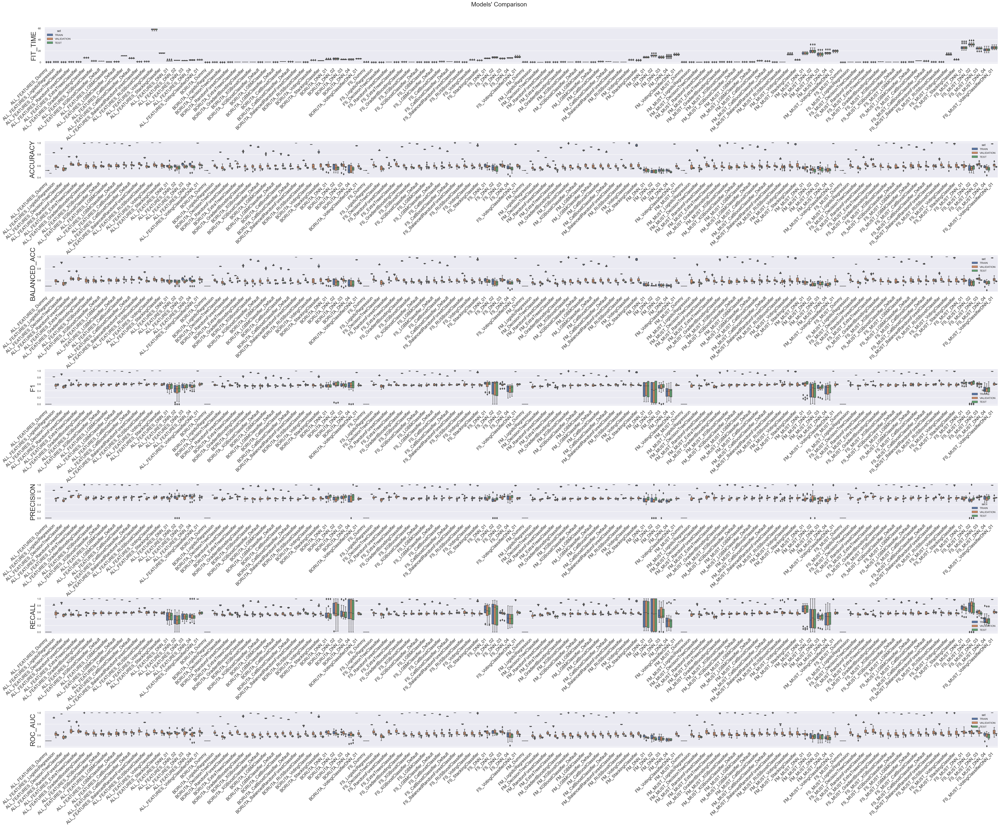

In [18]:
metrics = df_results_slim.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results_slim,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models_slim.png'),
    hue='set'

)

# Analyzing the Results

In [19]:
df_results.sample(10)

,models,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
200,ALL_FEATURES_XGBoostClassifier_Default,1.74,0.58,1.00,0.60,0.58,1.00,0.59,0.58,1.00,0.57,0.62,1.00,0.58,0.55,1.00,0.56,0.62,1.00,0.67
261,BORUTA_DNN_03,4.06,0.58,0.62,0.64,0.60,0.61,0.63,0.52,0.53,0.56,0.67,0.65,0.67,0.42,0.46,0.48,0.62,0.64,0.67
62,ALL_FEATURES_DNN_04,3.50,0.61,0.63,0.61,0.61,0.63,0.61,0.60,0.59,0.57,0.65,0.63,0.61,0.56,0.56,0.53,0.65,0.68,0.64
1234,FS_VotingClassifierDNN_01,8.78,0.58,0.98,0.63,0.58,0.98,0.63,0.58,0.98,0.61,0.61,0.99,0.62,0.56,0.97,0.59,0.62,1.00,0.69
884,FS_DNN_02,8.58,0.60,0.62,0.59,0.59,0.63,0.60,0.64,0.66,0.65,0.61,0.59,0.56,0.67,0.75,0.77,0.64,0.68,0.64
919,FS_DecisionTreeClassifier,0.04,0.55,0.86,0.53,0.55,0.86,0.53,0.54,0.85,0.50,0.59,0.86,0.51,0.50,0.85,0.50,0.59,0.95,0.54
589,FM_MUST_CatBoostClassifier_Default,1.86,0.58,0.88,0.55,0.58,0.88,0.55,0.58,0.88,0.54,0.61,0.91,0.53,0.55,0.84,0.56,0.61,0.96,0.58
723,FM_MUST_StackingClassifier,3.92,0.57,0.99,0.62,0.58,0.99,0.62,0.58,0.99,0.59,0.61,1.00,0.61,0.54,0.98,0.57,0.61,1.00,0.63
1067,FS_MUST_Dummy,0.05,0.47,0.52,0.52,0.50,0.50,0.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.50,0.50
583,FM_MUST_CatBoostClassifier_Default,1.65,0.59,0.87,0.62,0.59,0.87,0.62,0.59,0.86,0.59,0.63,0.89,0.61,0.55,0.83,0.57,0.62,0.95,0.65


In [20]:
df_results.groupby(['models']).mean().nlargest(10,'VALIDATION_ROC_AUC').sort_values('VALIDATION_ROC_AUC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_RandomForestClassifier,0.44,0.61,0.76,0.64,0.62,0.76,0.63,0.58,0.73,0.58,0.68,0.80,0.65,0.51,0.66,0.53,0.67,0.85,0.68
FS_MUST_ExtraTreesClassifier,0.12,0.59,0.71,0.63,0.60,0.71,0.63,0.56,0.67,0.58,0.65,0.74,0.64,0.49,0.62,0.53,0.64,0.79,0.68
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
ALL_FEATURES_ExtraTreesClassifier,0.46,0.62,0.76,0.64,0.62,0.76,0.63,0.58,0.72,0.58,0.69,0.82,0.65,0.51,0.64,0.51,0.67,0.84,0.68
FS_MUST_RandomForestClassifier,0.16,0.60,0.75,0.63,0.60,0.74,0.62,0.59,0.72,0.59,0.65,0.76,0.63,0.54,0.68,0.56,0.64,0.83,0.67
FS_ExtraTreesClassifier,0.09,0.59,0.71,0.63,0.60,0.70,0.63,0.56,0.67,0.58,0.65,0.73,0.64,0.50,0.61,0.54,0.63,0.78,0.66
FS_DNN_03,6.65,0.60,0.63,0.62,0.61,0.62,0.61,0.59,0.59,0.58,0.65,0.62,0.61,0.54,0.57,0.56,0.64,0.67,0.66
ALL_FEATURES_VotingClassifierDNN_01,4.04,0.61,0.99,0.62,0.61,0.99,0.62,0.61,0.99,0.59,0.64,1.00,0.62,0.58,0.99,0.57,0.64,1.00,0.66
FM_MUST_RandomForestClassifier,0.16,0.59,0.75,0.62,0.59,0.75,0.62,0.58,0.73,0.59,0.63,0.77,0.62,0.54,0.69,0.56,0.63,0.83,0.66


In [21]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_F1').sort_values('VALIDATION_F1',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
FS_MUST_DNN_01,26.80,0.60,0.61,0.60,0.59,0.62,0.60,0.64,0.64,0.63,0.61,0.58,0.57,0.67,0.71,0.70,0.64,0.66,0.65
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
FS_MUST_DNN_03,24.12,0.60,0.63,0.63,0.60,0.63,0.63,0.59,0.60,0.60,0.65,0.62,0.62,0.55,0.59,0.59,0.64,0.67,0.66
FS_MUST_VotingClassifierDNN_01,25.83,0.58,0.98,0.61,0.58,0.98,0.61,0.60,0.98,0.60,0.61,0.99,0.60,0.59,0.98,0.61,0.62,1.00,0.65
ALL_FEATURES_VotingClassifier,57.61,0.60,1.00,0.62,0.61,1.00,0.62,0.61,1.00,0.60,0.64,1.00,0.61,0.58,1.00,0.59,0.64,1.00,0.66


In [22]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_BALANCED_ACC').sort_values('VALIDATION_BALANCED_ACC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_BalancedRandomForestClassifier,0.87,0.61,1.00,0.63,0.61,1.00,0.63,0.62,1.00,0.62,0.65,1.00,0.62,0.59,1.00,0.62,0.66,1.00,0.68
ALL_FEATURES_ExtraTreesClassifier,0.46,0.62,0.76,0.64,0.62,0.76,0.63,0.58,0.72,0.58,0.69,0.82,0.65,0.51,0.64,0.51,0.67,0.84,0.68
ALL_FEATURES_RandomForestClassifier,0.44,0.61,0.76,0.64,0.62,0.76,0.63,0.58,0.73,0.58,0.68,0.80,0.65,0.51,0.66,0.53,0.67,0.85,0.68
FS_MUST_DNN_03,24.12,0.60,0.63,0.63,0.60,0.63,0.63,0.59,0.60,0.60,0.65,0.62,0.62,0.55,0.59,0.59,0.64,0.67,0.66
FS_ExtraTreesClassifier,0.09,0.59,0.71,0.63,0.60,0.70,0.63,0.56,0.67,0.58,0.65,0.73,0.64,0.50,0.61,0.54,0.63,0.78,0.66


In [23]:
SELECTED_MODELS = sorted([col for col in results.keys() if 'Dummy' not in col and results[col]['ROC_AUC']['VALIDATION'].mean() > 0.65])
THRESHOLD = 0.5

In [24]:
# reading files

df_train=pd.read_parquet(osp.join(ALL_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(ALL_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [25]:
predictions = {}
predictions_proba = {}
for name, model in trained_models.items():
    if name in SELECTED_MODELS:
        predictions[name] = model.predict(X_test)
        predictions_proba[name] = model.predict_proba(X_test)[:,1]

2023-09-21 18:20:19.477802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:21.589382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:23.091556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:23.995348: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:24.816942: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:27.193154: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2023-09-21 18:20:28.783634: I tensorflow/core/grappler/optimizers/cust

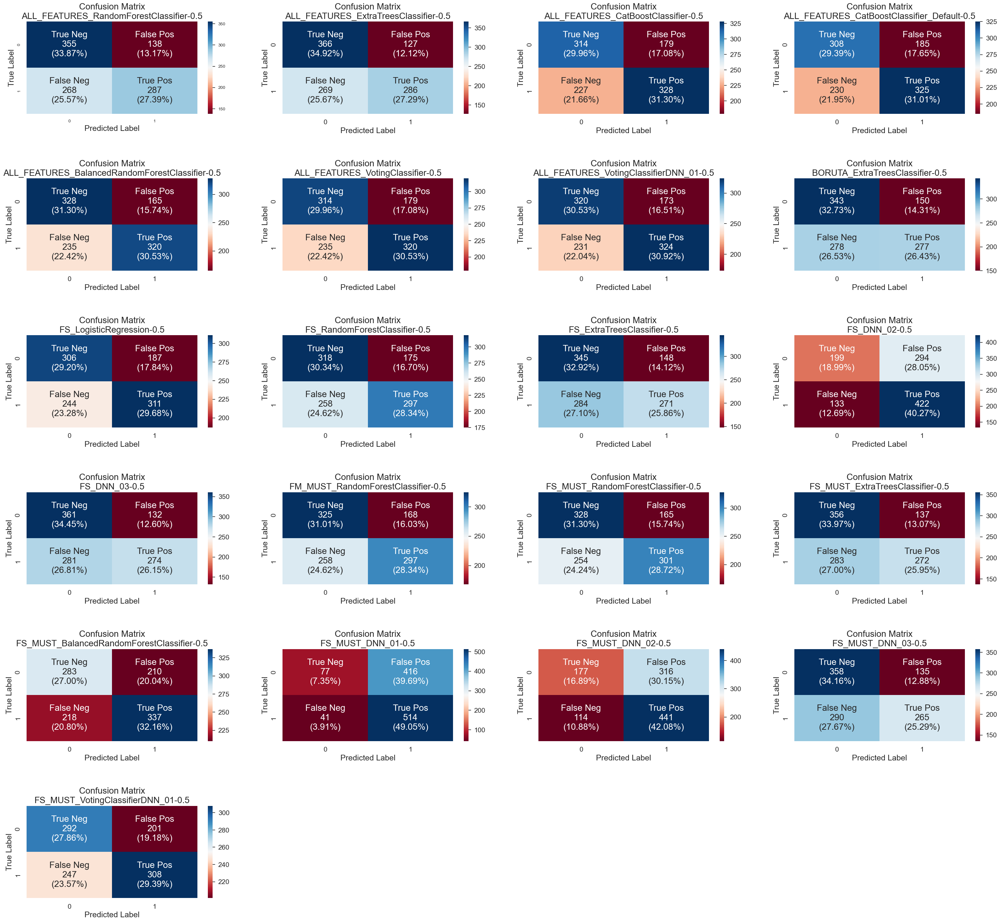

In [26]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_confusion_matrix(y_real = y_test, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}', ax = ax)

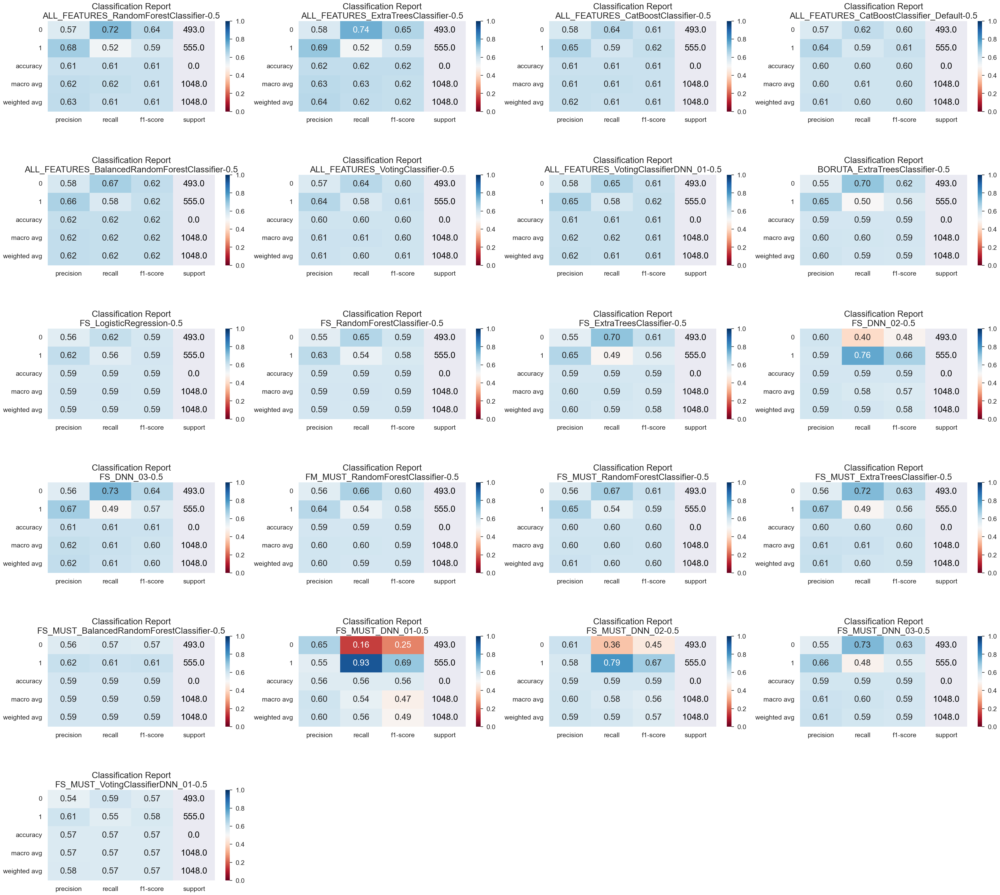

In [27]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_classification_report_sns(y_real = y_test, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}', ax = ax)

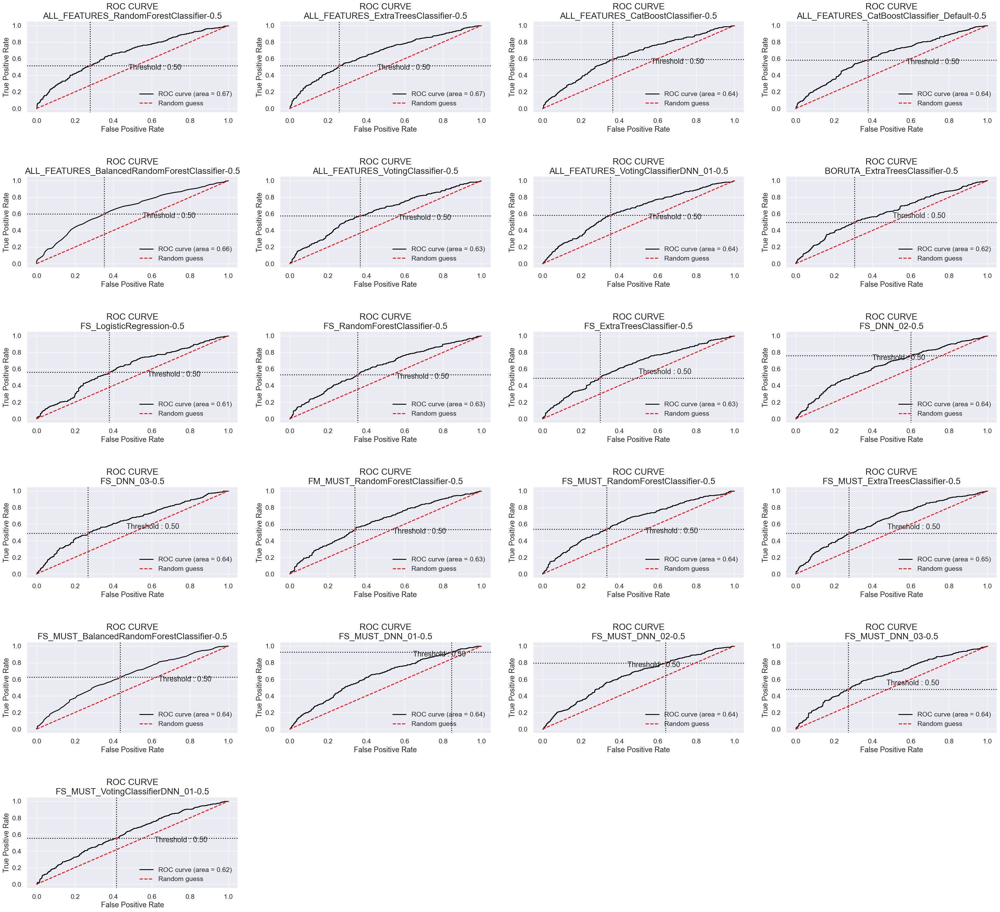

In [28]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_roc_sns(y_real = y_test, y_pred= y_pred, title=f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', ax = ax)

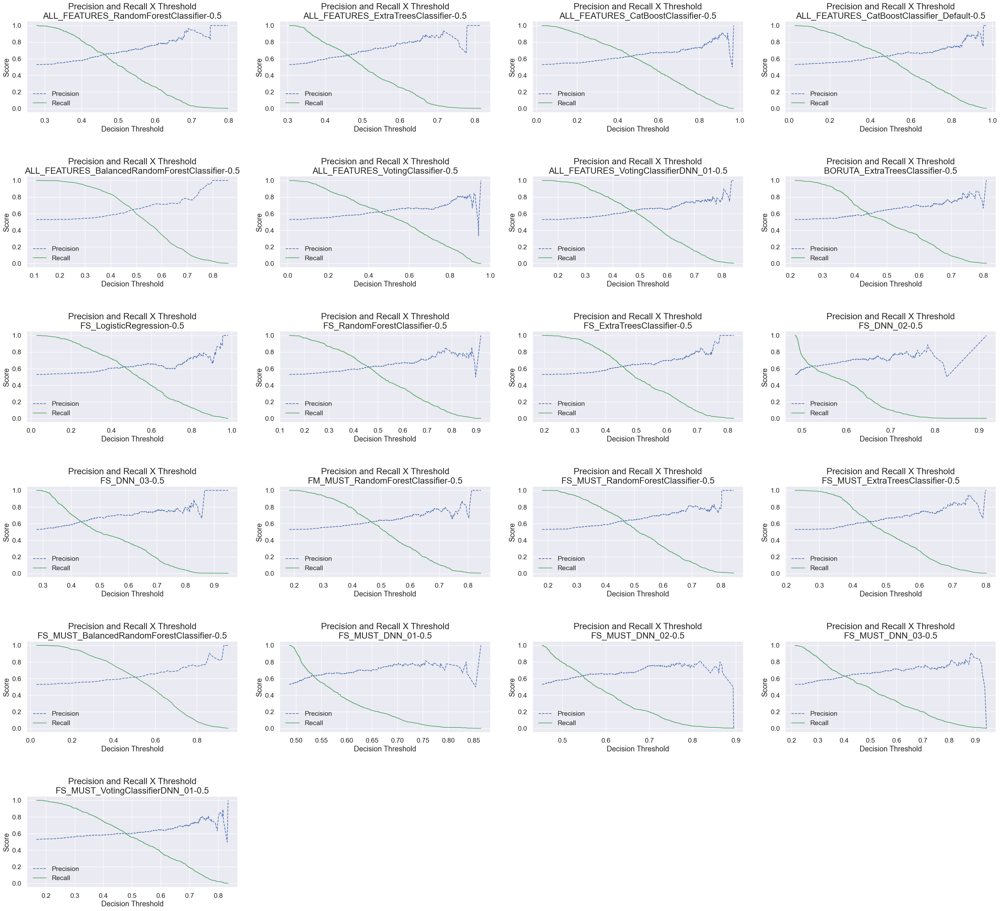

In [29]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_precision_recall_vs_threshold(y_real = y_test, y_pred= y_pred, title=f'Precision and Recall X Threshold\n{name}-{round(THRESHOLD,2)}', ax = ax)

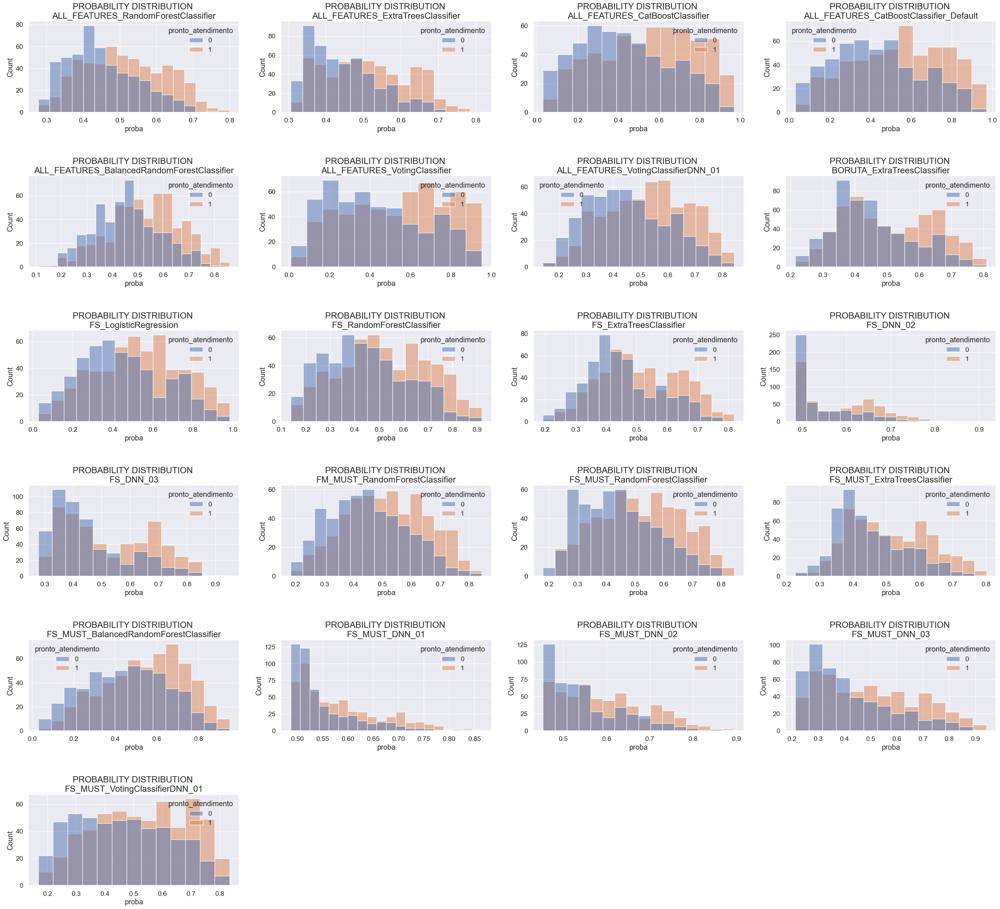

In [30]:
import seaborn as sns

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    df_proba = pd.concat([pd.Series(y_pred, name = 'proba', index = y_test.index), y_test], axis = 1)
    try:
        sns.histplot(data = df_proba, x = 'proba', hue = y_test.name, ax = ax)
        ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)
    except:
        pass

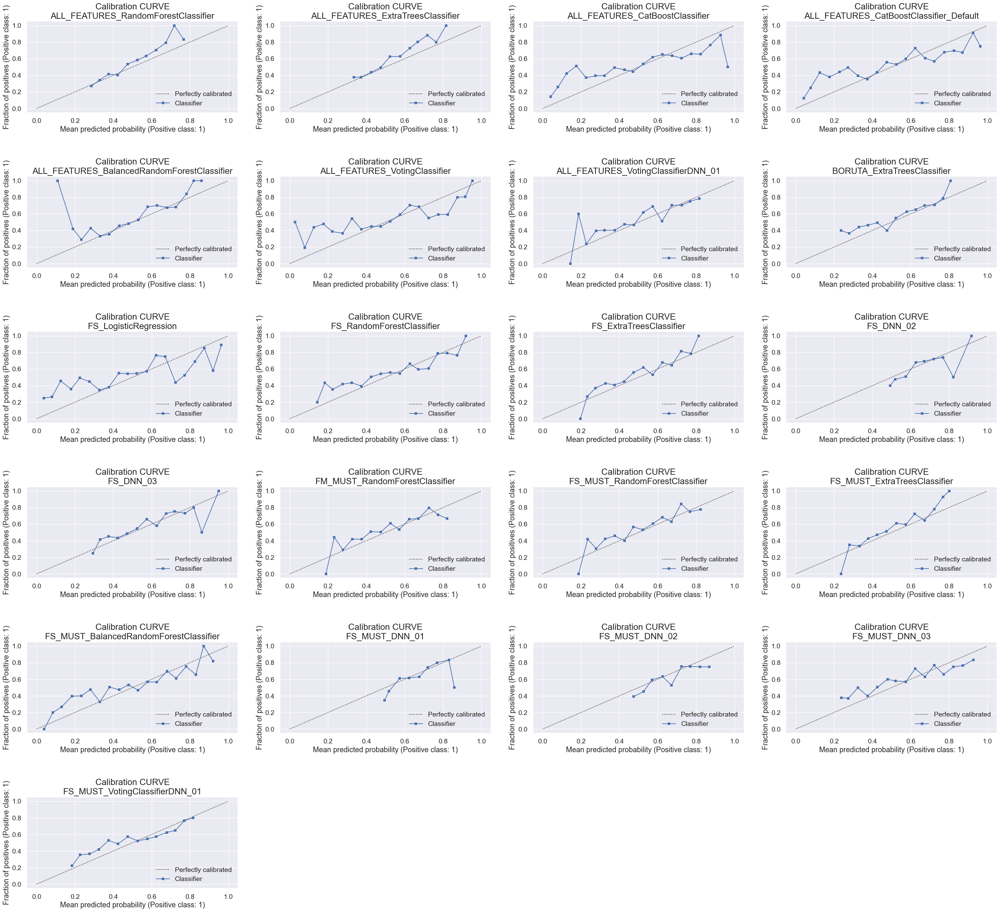

In [31]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_calibration_curve(y_real = y_test, y_pred= y_pred, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

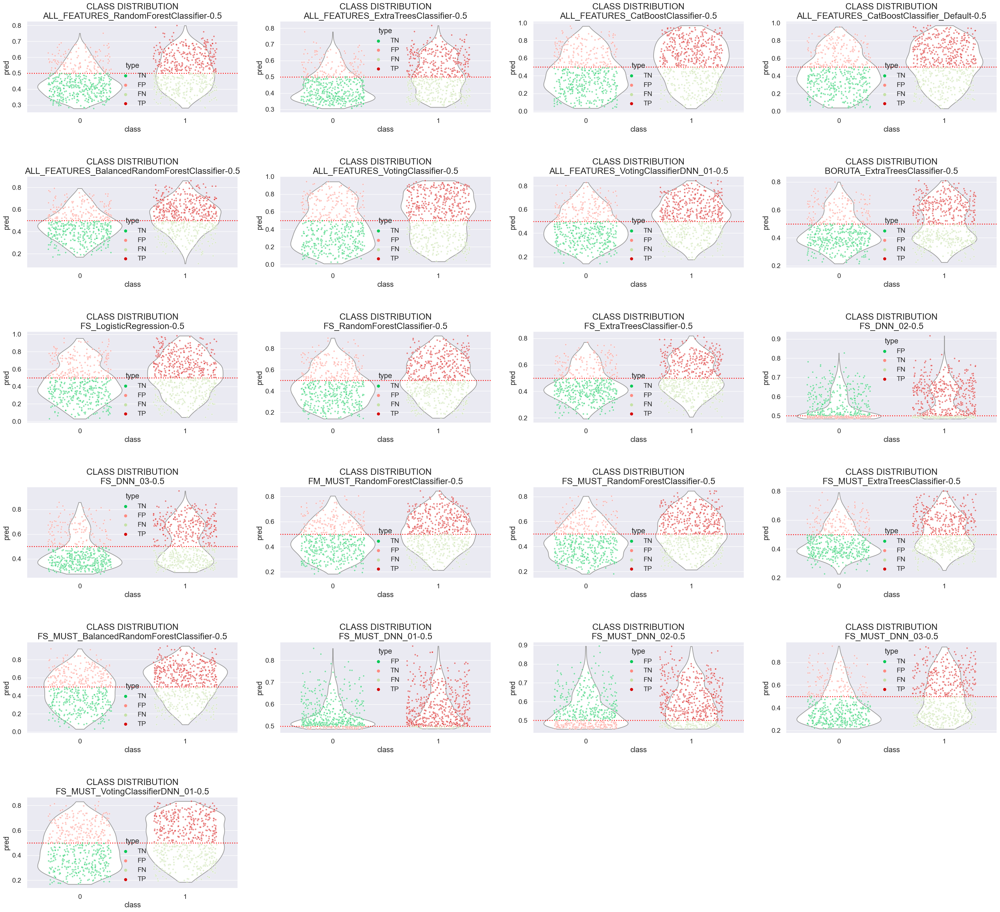

In [32]:
from plot_metric.functions import BinaryClassification
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    bc = BinaryClassification(y_true = y_test, y_pred= y_pred, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
    bc.plot_class_distribution()
    title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

# Tunning Hyperparameters

In [33]:
chosen_model_name = "BORUTA_LGBMClassifier"

chosen_model  = read_joblib(osp.join(MODELS_DIR, chosen_model_name ,'model.p'))
pipe = clone(chosen_model)

In [34]:
# reading files

df_train=pd.read_parquet(osp.join(BORUTA_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(BORUTA_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [35]:
pipe

Pipeline(steps=[('preprocessor',
                 Pipeline(steps=[('preprocessor',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('float',
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer()),
                                                                                   ('scaler',
                                                                                    StandardScaler())]),
                                                                   ['nserv',
                                                                    'bmi',
                                                                    'urg']),
                                                                  ('int',
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer(strategy='most_frequent')),
                                                                                   ('scaler',
                                                                                    StandardScaler())]),
                                                                   []),
                                                                  ('categorical_l...
                                                                   Pipeline(steps=[('imputer',
                                                                                    SimpleImputer(fill_value='missing',
                                                                                                  strategy='constant')),
                                                                                   ('encoder',
                                                                                    TargetEncoder())]),
                                                                   ['setor',
                                                                    'postoqual',
                                                                    'qplan']),
                                                                  ('bypass',
                                                                   Pipeline(steps=[('Bypass',
                                                                                    <src.ml.utils.preprocessors.BypassTransformer object at 0xafd5ed160>)]),
                                                                   [])])),
                                 ('sparse_to_dense',
                                  SparseToDenseTransformer())])),
                ('model',
                 LGBMClassifier(max_depth=7, random_state=123, verbose=0))])

## Randomized Search CV

In [36]:
preprocessor_search_space = {
    'preprocessor__float__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
                
    'preprocessor__float__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
        ],
    
    'preprocessor__int__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="most_frequent"),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
    
    'preprocessor__int__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
    ]
}

In [37]:
search_space = [              
    {'model': [LGBMClassifier(random_state=SEED)],
        'model__n_estimators': [30, 100, 400, 700, 1000],
        'model__colsample_bytree': [0.7, 0.8],
        'model__max_depth': [3, 5, 10, 15, 20],
        'model__num_leaves': [50, 100, 200],
        'model__reg_alpha': [1.1, 1.2, 1.3],
        'model__reg_lambda': [1.1, 1.2, 1.3],
        'model__min_split_gain': [0.3, 0.4],
        'model__min_child_samples': [10, 20, 30, 40, 50],
        'model__subsample': [0.7, 0.8, 0.9],
        'model__subsample_freq': [20, 10],
    **preprocessor_search_space
    }
]

In [38]:
SAMPLE_SIZE = 1000000

X_train_sample = X_train.sample(min(SAMPLE_SIZE,X_train.shape[0]))
# X_train_sample = X_train
y_train_sample = y_train.loc[X_train_sample.index]            

optimizer = None
optimizer=RandomizedSearch(pipe=pipe
            , search_space=search_space
            , X_train=X_train_sample
            , y_train=y_train_sample
            , scoring=metrics
            , refit = 'roc_auc'
            , n_iter=100
            , n_folds=N_FOLDS
            , verbose = 1
            )

print('Finished fitting optimizer')
best_model = optimizer.best_estimator_

print('Retraining best model')

best_model.fit(X_train, y_train)

write_joblib(best_model, osp.join(MODELS_DIR, 'best_model.joblib'))


ValueError: 'FIT_TIME' is not a valid scoring value. Use sklearn.metrics.get_scorer_names() to get valid options.

In [ ]:
best_model

In [ ]:
y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)

max_metric_len = max([len(metric_name) for metric_name in metrics])
msg_metrics = f""
for metric_name, scorer in metrics.items():
    
    train_scorer = get_metric_result(
        scorer, y_train, y_pred_train,y_proba=y_proba_train
    )
    test_scorer = get_metric_result(
        scorer, y_test, y_pred_test, y_proba=y_proba_test
    )

    msg_metrics += f" - {metric_name.upper()}{' '*(max_metric_len-len(metric_name))}\t->\tTRAIN: {train_scorer:.2f} | TEST:{test_scorer:.2f}\n"
    
print(msg_metrics)

# Best Model

In [ ]:
best_model  = read_joblib(osp.join(MODELS_DIR, 'best_model.joblib'))

name = chosen_model_name

y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)[:,1]
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)[:,1]

In [ ]:
y = y_test
y_pred = y_pred_test
y_proba = y_proba_test

## Metrics

### Precision and Recall x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_precision_recall_vs_threshold(y_real = y, y_pred= y_proba, title=f'Precision and Recall X Threshold\n{name}', ax = ax)

### Calibration Curve

In [ ]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_calibration_curve(y_real = y, y_pred= y_proba, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

### Probability Distribution

In [ ]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

df_proba = pd.concat([pd.Series(y_proba, name = 'proba', index = y.index), y], axis = 1)

sns.histplot(data = df_proba, x = 'proba', hue = y.name, ax = ax)
ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)

plt.show()

### Confusion Matrix x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_confusion_matrix(y_real = y, y_pred= y_pred_threshold, title=f'Confusion Matrix\n{name}-{round(threshold,2)}', ax = ax)

### Classification Report x Threshold

In [ ]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_classification_report_sns(y_real = y, y_pred= y_pred_threshold, title=f'Classification Report\n{name}-{round(threshold,2)}', ax = ax)

### Defining Threshold

In [ ]:
THRESHOLD = 0.35
y_pred = best_model.predict_proba(X_test)[:,1]>THRESHOLD

### Confusion Matrix

In [ ]:
plot_confusion_matrix(y_real =y, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}')

### Classification Report

In [ ]:
plot_classification_report_sns(y_real = y, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}')

### Roc Curve

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 1", "Class 2"], threshold = THRESHOLD)
bc.plot_roc_curve()
title: ax.set_title(f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Precision x Recall

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_precision_recall_curve()
title: ax.set_title(f'PRECISION X RECALL\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Class Distribution

In [ ]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_class_distribution()
title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

## Shap

In [ ]:
import shap

shap.initjs()

model = best_model

# Using a random sample of the dataframe for better time computation
X_train_sampled = X_train.sample(30, random_state=10)
X_test_sampled = X_test.sample(1000, random_state=10)

# explain the model's predictions using SHAP values
def model_predict(data_asarray, model = model, columns=X_train_sampled.columns):
    data_asframe = pd.DataFrame(data_asarray, columns=columns)
    predictions = model.predict_proba(data_asframe)
    return predictions

explainer = shap.KernelExplainer(model = model_predict, data = X_train_sampled, link = "identity")
shap_values = explainer.shap_values(X_test_sampled)

In [ ]:
shap.summary_plot(shap_values[1], X_test_sampled, plot_size = (18,10))

In [ ]:
shap.force_plot(explainer.expected_value[0], shap_values[0][0], feature_names = X_train_sampled.columns, link = 'logit')

In [ ]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1], shap_values[1][0], feature_names= X_train_sampled.columns)

In [ ]:
shap.summary_plot(shap_values, plot_type = 'bar', feature_names = X_train_sampled.columns, plot_size=(18,10))

In [ ]:
shap.decision_plot(explainer.expected_value[1], shap_values[1][:500], feature_names = X_test_sampled.columns.to_list(), xlim = (-0.1,1),
                   feature_order = 'hclust')

In [ ]:
shap.plots.force(explainer.expected_value[1], shap_values[1], feature_names = X_test_sampled.columns.to_list())